# Introduction

Up until recently I have been working with the RAVDESS data set and discovered a new one with over 7000 samples called CREMA.
These audio data sets are intended to explore speech emotion recognition. The main tools to explore these datasets have been
librosa, Pandas and various classifiers. There is a large number of features that could be extracted from an audio file along 
with various statistics applied to each feature. This notebook will explore narrowing down those features and statistics in 
order to create a set of important features useful in extracting emotions from audio data. There's also another one called 
TESS but it has 2800 files so I may dive into that one as well. Below is an exploration mostly of RAVEDESS to get an understanding of the features and how they interact with each other and certain emotions. There is a lot of subtlety between emotions that comes out with various features and I explore some options with RandomForest and GradientBoosting. Currently I have 69 features extracted but hope to narrow it down to about 20.

***Also, I added a shortcut below each header throughout the notebook that says <span style="color:red">'Contents'</span> that when click will bring you back
to the top to more easily navigate. I will use this method going forward.***

## Contents

* [Introduction](#Introduction)
    * [Imports](#Imports)
    * [About the RAVDESS dataset](#About_the_RAVDESS_dataset)
    * [About the CREMA-D dataset](#About_the_CREMA-D_dataset)
* [Exploring the data](#Exploring_the_data)
    * [Correlation](#Correlation)
    * [Distributions Of Feature Values](#Distributions_Of_Feature_Values)
    * [Investigating relationships with pairplot](#Investigating_relationships_with_pairplot)
        * [Mean pairplots](#Mean_pairplots)
* [Exploring features with models](#Exploring_features_with_models)
    * [Random Forest with RAVDESS](#Random_Forest_with_RAVDESS)
        * [Random Forest results](#Random_Forest_results)
    * [Gradient Boosting with RAVDESS](#Gradient_Boosting_with_RAVDESS)
        * [Gradient Boosting results](#Gradient_Boosting_results)
* [Feature importance](#Feature_importance)
* [Conclusion](#Conclusion)

## Imports

In [1]:
# Importing libraries necessary to perform analysis
import librosa
import librosa.display
import soundfile
import pandas as pd
import os, glob, pickle
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy

from sklearn.model_selection import train_test_split, RandomizedSearchCV, GridSearchCV, cross_val_score
from sklearn.neural_network import MLPClassifier
from sklearn.utils import resample
from sklearn.neighbors import KNeighborsClassifier
from sklearn.pipeline import Pipeline
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, roc_curve, auc, roc_auc_score, precision_recall_curve
from sklearn.preprocessing import StandardScaler, label_binarize
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier

from dotenv import load_dotenv, find_dotenv

import warnings

# Suppress specific warnings related to certain modules
warnings.filterwarnings('ignore', module='seaborn')
warnings.filterwarnings('ignore', module='pandas')
warnings.filterwarnings('ignore', module='AdaBoostClassifier')

load_dotenv()
sound_path = os.getenv('audio_path')

## About the RAVDESS dataset<a id='About_the_RAVDESS_dataset'></a>

* [Contents](#Contents)

This dataset is pulled from the Ryerson Audio-Visual Database of Emotional Speech and Song (RAVDESS). It has 
classifications that are contained in the file names. They are as follows:

Filename identifiers

Modality (01 = full-AV, 02 = video-only, 03 = audio-only).

Vocal channel (01 = speech, 02 = song).

Emotion (01 = neutral, 02 = calm, 03 = happy, 04 = sad, 05 = angry, 06 = fearful, 07 = disgust, 08 = surprised).

Emotional intensity (01 = normal, 02 = strong). NOTE: There is no strong intensity for the 'neutral' emotion.

Statement (01 = "Kids are talking by the door", 02 = "Dogs are sitting by the door").

Repetition (01 = 1st repetition, 02 = 2nd repetition).

Actor (01 to 24. Odd numbered actors are male, even numbered actors are female).

Filename example: 03-01-06-01-02-01-12.wav

Audio-only (03)
Speech (01)
Fearful (06)
Normal intensity (01)
Statement "dogs" (02)
1st Repetition (01)
12th Actor (12)
Female, as the actor ID number is even.

Academic citation

If you use the RAVDESS in an academic publication, please use the following citation: Livingstone SR, Russo FA (2018) 
    The Ryerson Audio-Visual Database of Emotional Speech and Song (RAVDESS): A dynamic, multimodal set of facial and 
        vocal expressions in North American English. PLoS ONE 13(5): e0196391. https://doi.org/10.1371/journal.pone.0196391.

All other attributions

If you use the RAVDESS in a form other than an academic publication, such as in a blog post, school project, or 
non-commercial product, please use the following attribution: "The Ryerson Audio-Visual Database of Emotional Speech 
    and Song (RAVDESS)" by Livingstone & Russo is licensed under CC BY-NA-SC 4.0.

## About the CREMA-D dataset<a id='About_the_CREMA-D_dataset'></a>

* [Contents](#Contents)

Filename labeling conventions
The Actor id is a 4 digit number at the start of the file. Each subsequent identifier is separated by an underscore (_).


Actors spoke from a selection of 12 sentences 
(in parentheses is the three letter acronym used in the second part of the filename):


    It's eleven o'clock (IEO). 
    That is exactly what happened (TIE). 
    I'm on my way to the meeting (IOM). 
    I wonder what this is about (IWW). 
    The airplane is almost full (TAI). 
    Maybe tomorrow it will be cold (MTI). 
    I would like a new alarm clock (IWL). 
    I think I have a doctor's appointment (ITH). 
    Don't forget a jacket (DFA). 
    I think I've seen this before (ITS). 
    The surface is slick (TSI). 
    We'll stop in a couple of minutes (WSI). 


The sentences were presented using different emotion 
(in parentheses is the three letter code used in the third part of the filename):


    Anger (ANG)
    Disgust (DIS)
    Fear (FEA)
    Happy/Joy (HAP)
    Neutral (NEU)
    Sad (SAD)


and emotion level (in parentheses is the two letter code used in the fourth part of the filename):

Low (LO)
Medium (MD)
High (HI)
Unspecified (XX)
The suffix of the filename is based on the type of file, flv for flash video used for presentation of 
both the video only, and the audio-visual clips. mp3 is used for the audio files used for the audio-only 
presentation of the clips. wav is used for files used for computational audio processing.

This dataset did not have sex classification in the file name so I had to post process the csv file with information 
from the actor sheet on the original github site: https://github.com/CheyneyComputerScience/CREMA-D

# Exploring the data<a id='Exploring_the_data'></a>

* [Contents](#Contents)

In [2]:
data1 = pd.read_csv('voice_data_dw.csv')    # RAVDESS data, dw = data wrangling
data2 = pd.read_csv('voice_data_dw_c.csv')     # CREMA-D data
data3 = pd.read_csv('voice_data_dw_t.csv')     # CREMA-D data
df = pd.DataFrame(data1)
df_c = pd.DataFrame(data2)
df_t = pd.DataFrame(data3)
pd.set_option('display.max_columns', None)
df.head()

,filename,modality,vocal_channel,emotion,voice_intensity,statement,statement_repetition,actor_gender,mfcc_mean,mfcc_max,mfcc_min,mfcc_median,mfcc_std,mfcc_skew,mfcc_kurtosis,mfcc_delta_mean,mfcc_delta_max,mfcc_delta_min,mfcc_delta_median,mfcc_delta_std,mfcc_delta_skew,mfcc_delta_kurtosis,mfcc_delta2_mean,mfcc_delta2_max,mfcc_delta2_min,mfcc_delta2_median,mfcc_delta2_std,mfcc_delta2_skew,mfcc_delta2_kurtosis,chroma_mean,chroma_min,chroma_max,chroma_median,chroma_std,chroma_skew,chroma_kurtosis,mel_mean,mel_max,mel_min,mel_median,mel_std,mel_skew,mel_kurtosis,contrast_mean,contrast_max,contrast_min,contrast_median,contrast_std,contrast_skew,contrast_kurtosis,centroid_mean,centroid_max,centroid_min,centroid_median,centroid_std,centroid_skew,centroid_kurtosis,roll_off_mean,roll_off_max,roll_off_min,roll_off_median,roll_off_std,roll_off_skew,roll_off_kurtosis,rms_mean,rms_max,rms_min,rms_median,rms_std,rms_skew,rms_kurtosis,zero_cr_mean,zero_cr_max,zero_cr_min,zero_cr_median,zero_cr_std,zero_cr_skew,zero_cr_kurtosis
0,03-01-01-01-01-01-01.wav,3,1,1,1,1,1,1,-16.392443,202.98502,-645.92170,-7.125899,82.844154,0.365277,0.181984,3.290076,36.87685,-15.079271,0.568462,8.395280,1.881931,2.384150,-2.929066,16.196424,-35.155490,-0.093855,9.038805,-1.890271,2.538881,0.607089,0.141472,1.0,0.600354,0.236534,0.086949,-0.952044,0.007324,1.707622,1.860741e-18,0.000056,0.045920,3.904024,16.927513,24.848774,81.737506,4.558243,18.060076,19.179764,-0.332873,0.920353,2862.926393,7495.930442,1162.137023,2306.370804,1505.855829,1.652513,1.915730,5278.790509,11923.828125,1998.046875,4651.367188,2714.027774,0.948544,-0.035782,0.005870,0.012585,0.001015,0.005574,0.002752,0.523488,-0.223807,0.071506,0.208984,0.023438,0.046875,0.049214,1.349598,0.792986
1,03-01-01-01-01-02-01.wav,3,1,1,1,1,2,1,-16.195488,193.51984,-644.16350,-6.892159,83.358950,0.258790,-0.088001,3.281766,36.88804,-14.507144,0.626492,8.581219,1.857355,2.298338,-3.001566,15.750255,-34.858368,-0.140539,9.143971,-1.889248,2.497091,0.565118,0.135088,1.0,0.526963,0.247438,0.231975,-0.966832,0.008445,1.459130,1.702563e-18,0.000053,0.052460,3.737249,15.052235,25.445381,81.394861,5.744724,18.907480,19.201790,0.101690,2.415374,2856.267937,7574.012464,1196.255587,2532.671446,1438.028687,1.745676,2.597192,5509.765625,11837.890625,2041.015625,5156.250000,2578.736315,0.814459,0.048691,0.006225,0.013047,0.001003,0.005672,0.003002,0.472005,-0.447499,0.063912,0.183105,0.019531,0.048340,0.042300,1.347601,0.843776
2,03-01-01-01-02-01-01.wav,3,1,1,1,2,1,1,-15.760641,209.64243,-599.33685,-6.811954,80.973440,0.349635,-0.079561,3.183938,33.61964,-16.218931,0.521331,8.188260,1.812531,2.258523,-2.733035,16.290403,-33.561646,-0.003302,8.798903,-1.845969,2.446758,0.566147,0.085513,1.0,0.543228,0.236025,0.195621,-0.746908,0.011151,1.726585,2.294504e-18,0.000077,0.065326,3.784763,16.238434,25.271402,84.231012,3.335950,18.387247,19.357776,-0.364876,1.243544,3147.076638,9735.443474,1074.722832,2347.152059,2109.463110,1.894945,2.580431,5705.295139,12525.390625,1890.625000,5059.570312,3023.452212,0.877642,-0.247283,0.007237,0.017973,0.001440,0.006281,0.003825,1.126351,0.754771,0.086652,0.424316,0.014648,0.048340,0.091483,2.158822,4.017514
3,03-01-01-01-02-02-01.wav,3,1,1,1,2,2,1,-16.046278,215.37698,-620.35815,-7.427359,81.609146,0.240670,-0.124088,3.185494,34.72454,-14.316382,0.496043,8.297734,1.826856,2.279578,-2.840508,17.101452,-35.499820,-0.068866,8.946567,-1.873974,2.477692,0.605738,0.112530,1.0,0.586911,0.229687,0.158463,-0.645343,0.010260,1.904755,2.764673e-18,0.000067,0.061361,3.518846,13.859685,25.348465,82.521337,4.348983,19.184102,19.175904,-0.306959,0.998655,3128.884756,9390.101251,1315.933093,2504.069840,2070.285142,1.732141,1.991167,5710.712139,12482.421875,1847.656250,5134.765625,3071.179190,0.797591,-0.433007,0.006781,0.018386,0.001300,0.005872,0.004013,1.583204,1.841371,0.088229,0.406250,0.013184,0.047852,0.093873,1.803562,2.245144
4,03-01-02-01-01-01-01.wav,3,1,2,1,1,1,1,-16.582544,205.08063,-692.11237,-

In [6]:
df_c.head()

,filename,statement,emotion,voice_intensity,mfcc_mean,mfcc_max,mfcc_min,mfcc_median,mfcc_std,mfcc_skew,mfcc_kurtosis,mfcc_delta_mean,mfcc_delta_max,mfcc_delta_min,mfcc_delta_median,mfcc_delta_std,mfcc_delta_skew,mfcc_delta_kurtosis,mfcc_delta2_mean,mfcc_delta2_max,mfcc_delta2_min,mfcc_delta2_median,mfcc_delta2_std,mfcc_delta2_skew,mfcc_delta2_kurtosis,chroma_mean,chroma_min,chroma_max,chroma_median,chroma_std,chroma_skew,chroma_kurtosis,mel_mean,mel_max,mel_min,mel_median,mel_std,mel_skew,mel_kurtosis,contrast_mean,contrast_max,contrast_min,contrast_median,contrast_std,contrast_skew,contrast_kurtosis,centroid_mean,centroid_max,centroid_min,centroid_median,centroid_std,centroid_skew,centroid_kurtosis,roll_off_mean,roll_off_max,roll_off_min,roll_off_median,roll_off_std,roll_off_skew,roll_off_kurtosis,rms_mean,rms_max,rms_min,rms_median,rms_std,rms_skew,rms_kurtosis,zero_cr_mean,zero_cr_max,zero_cr_min,zero_cr_median,zero_cr_std,zero_cr_skew,zero_cr_kurtosis
0,1001_DFA_ANG_XX.wav,DFA,anger,XX,-7.861806,172.13882,-367.82138,-3.355731,45.420494,-0.083274,-0.317473,1.187952,16.956244,-12.737326,0.423875,3.606701,0.693152,1.005156,-0.981090,13.191930,-17.895924,-0.240981,4.171079,-0.385588,2.576616,0.588556,0.163789,1.0,0.566777,0.228812,0.225032,-0.662147,1.239642,206.462370,2.373865e-16,0.016901,6.900043,3.094822,10.779486,23.797403,79.505578,3.059759,17.288663,20.248185,0.061636,1.998101,3609.426934,7754.493084,1701.402784,3444.230591,1306.044737,1.413663,2.314508,6816.365560,13449.218750,2320.312500,6294.921875,2743.203390,0.863480,0.212954,0.078334,0.191608,0.016036,0.073865,0.048450,0.566373,-0.510565,0.105326,0.266113,0.041504,0.098877,0.046664,1.461352,2.607774
1,1001_DFA_DIS_XX.wav,DFA,disgust,XX,-9.452926,175.35466,-450.32560,-4.190086,53.548960,0.044376,-0.239999,1.546185,23.313921,-13.368842,0.411277,4.464417,1.251220,1.907795,-1.545072,13.445838,-26.327261,-0.118847,5.480439,-1.268124,2.561582,0.676517,0.187586,1.0,0.667416,0.204820,-0.105566,-0.637919,0.162168,21.914064,8.120840e-17,0.004463,0.836368,3.212106,11.721422,22.642638,82.147362,4.400302,15.951105,19.997707,0.022740,1.118758,3751.440501,8007.821995,2112.120462,3545.149524,1279.224074,1.674937,3.033505,6978.685462,13492.187500,3931.640625,5811.523438,2493.686061,1.244088,0.541582,0.028362,0.069885,0.004940,0.023955,0.015989,0.909930,0.185061,0.108738,0.271973,0.043945,0.106201,0.051661,1.394082,2.008864
2,1001_DFA_FEA_XX.wav,DFA,fearful,XX,-7.836610,138.94637,-321.09644,-3.260339,39.805393,-0.009055,-0.480545,1.125755,15.371421,-10.453515,0.433482,3.043510,0.394238,0.593903,-0.697880,10.824774,-15.925366,-0.153619,3.405736,-0.177140,2.267163,0.526264,0.122044,1.0,0.500715,0.247628,0.292454,-0.805667,2.282289,431.301270,6.593233e-16,0.036461,15.092337,2.765274,8.131363,23.860653,79.237179,3.045544,17.236737,19.232741,-0.000300,0.575309,3733.852313,8395.628866,2754.300466,3402.650261,1192.906545,2.441903,5.900998,6712.332589,14072.265625,3716.796875,5693.359375,2592.592934,1.565273,1.892657,0.110559,0.224669,0.014313,0.112171,0.058515,0.059786,-1.035065,0.103251,0.235840,0.040039,0.089355,0.046278,1.585550,1.822081
3,1001_DFA_HAP_XX.wav,DFA,happy,XX,-7.816556,159.30455,-369.91170,-3.084167,43.203660,0.120049,-0.126849,1.072193,18.129837,-11.115734,0.386965,3.254987,0.480288,0.642292,-0.817846,13.787669,-18.676065,-0.073203,3.848503,-0.298762,3.032291,0.609570,0.193454,1.0,0.593258,0.225788,0.175140,-0.797312,1.363221,241.798510,5.656082e-16,0.022572,8.080648,3.070979,9.987621,23.640892,80.958320,3.349195,17.190883,19.833611,-0.256704,0.505664,3581.831080,7748.041609,2192.063396,3333.595630,1115.076039,2.421424,6.498064,6748.416385,13535.156250,4039.062500,5929.687500,2215.827395,1.519381,2.082263,0.083394,0.189180,0.012610,0.077070,0.044943,0.600728,-0.537000,0.094951,0.221680,0.034668,0.086914,0.042843,1.538277,2.198416
4,1001_DFA_NEU_XX.wav,DFA,neutral,XX,-9.037200,176.85399,-421.88104,-3.800208,51.701850,0.062062,-0.284272,1.467234,21.755198,-12.428983,0.40343

In [7]:
df_t.head()

,filename,statement,emotion,voice_intensity,mfcc_mean,mfcc_max,mfcc_min,mfcc_median,mfcc_std,mfcc_skew,mfcc_kurtosis,mfcc_delta_mean,mfcc_delta_max,mfcc_delta_min,mfcc_delta_median,mfcc_delta_std,mfcc_delta_skew,mfcc_delta_kurtosis,mfcc_delta2_mean,mfcc_delta2_max,mfcc_delta2_min,mfcc_delta2_median,mfcc_delta2_std,mfcc_delta2_skew,mfcc_delta2_kurtosis,chroma_mean,chroma_min,chroma_max,chroma_median,chroma_std,chroma_skew,chroma_kurtosis,mel_mean,mel_max,mel_min,mel_median,mel_std,mel_skew,mel_kurtosis,contrast_mean,contrast_max,contrast_min,contrast_median,contrast_std,contrast_skew,contrast_kurtosis,centroid_mean,centroid_max,centroid_min,centroid_median,centroid_std,centroid_skew,centroid_kurtosis,roll_off_mean,roll_off_max,roll_off_min,roll_off_median,roll_off_std,roll_off_skew,roll_off_kurtosis,rms_mean,rms_max,rms_min,rms_median,rms_std,rms_skew,rms_kurtosis,zero_cr_mean,zero_cr_max,zero_cr_min,zero_cr_median,zero_cr_std,zero_cr_skew,zero_cr_kurtosis
0,1001_DFA_ANG_XX.wav,DFA,anger,XX,-7.861806,172.13882,-367.82138,-3.355731,45.420494,-0.083274,-0.317473,1.187952,16.956244,-12.737326,0.423875,3.606701,0.693152,1.005156,-0.981090,13.191930,-17.895924,-0.240981,4.171079,-0.385588,2.576616,0.588556,0.163789,1.0,0.566777,0.228812,0.225032,-0.662147,1.239642,206.462370,2.373865e-16,0.016901,6.900043,3.094822,10.779486,23.797403,79.505578,3.059759,17.288663,20.248185,0.061636,1.998101,3609.426934,7754.493084,1701.402784,3444.230591,1306.044737,1.413663,2.314508,6816.365560,13449.218750,2320.312500,6294.921875,2743.203390,0.863480,0.212954,0.078334,0.191608,0.016036,0.073865,0.048450,0.566373,-0.510565,0.105326,0.266113,0.041504,0.098877,0.046664,1.461352,2.607774
1,1001_DFA_DIS_XX.wav,DFA,disgust,XX,-9.452926,175.35466,-450.32560,-4.190086,53.548960,0.044376,-0.239999,1.546185,23.313921,-13.368842,0.411277,4.464417,1.251220,1.907795,-1.545072,13.445838,-26.327261,-0.118847,5.480439,-1.268124,2.561582,0.676517,0.187586,1.0,0.667416,0.204820,-0.105566,-0.637919,0.162168,21.914064,8.120840e-17,0.004463,0.836368,3.212106,11.721422,22.642638,82.147362,4.400302,15.951105,19.997707,0.022740,1.118758,3751.440501,8007.821995,2112.120462,3545.149524,1279.224074,1.674937,3.033505,6978.685462,13492.187500,3931.640625,5811.523438,2493.686061,1.244088,0.541582,0.028362,0.069885,0.004940,0.023955,0.015989,0.909930,0.185061,0.108738,0.271973,0.043945,0.106201,0.051661,1.394082,2.008864
2,1001_DFA_FEA_XX.wav,DFA,fearful,XX,-7.836610,138.94637,-321.09644,-3.260339,39.805393,-0.009055,-0.480545,1.125755,15.371421,-10.453515,0.433482,3.043510,0.394238,0.593903,-0.697880,10.824774,-15.925366,-0.153619,3.405736,-0.177140,2.267163,0.526264,0.122044,1.0,0.500715,0.247628,0.292454,-0.805667,2.282289,431.301270,6.593233e-16,0.036461,15.092337,2.765274,8.131363,23.860653,79.237179,3.045544,17.236737,19.232741,-0.000300,0.575309,3733.852313,8395.628866,2754.300466,3402.650261,1192.906545,2.441903,5.900998,6712.332589,14072.265625,3716.796875,5693.359375,2592.592934,1.565273,1.892657,0.110559,0.224669,0.014313,0.112171,0.058515,0.059786,-1.035065,0.103251,0.235840,0.040039,0.089355,0.046278,1.585550,1.822081
3,1001_DFA_HAP_XX.wav,DFA,happy,XX,-7.816556,159.30455,-369.91170,-3.084167,43.203660,0.120049,-0.126849,1.072193,18.129837,-11.115734,0.386965,3.254987,0.480288,0.642292,-0.817846,13.787669,-18.676065,-0.073203,3.848503,-0.298762,3.032291,0.609570,0.193454,1.0,0.593258,0.225788,0.175140,-0.797312,1.363221,241.798510,5.656082e-16,0.022572,8.080648,3.070979,9.987621,23.640892,80.958320,3.349195,17.190883,19.833611,-0.256704,0.505664,3581.831080,7748.041609,2192.063396,3333.595630,1115.076039,2.421424,6.498064,6748.416385,13535.156250,4039.062500,5929.687500,2215.827395,1.519381,2.082263,0.083394,0.189180,0.012610,0.077070,0.044943,0.600728,-0.537000,0.094951,0.221680,0.034668,0.086914,0.042843,1.538277,2.198416
4,1001_DFA_NEU_XX.wav,DFA,neutral,XX,-9.037200,176.85399,-421.88104,-3.800208,51.701850,0.062062,-0.284272,1.467234,21.755198,-12.428983,0.40343

## Correlation

* [Contents](#Contents)

In [4]:
df.iloc[:,8:].corr()

,mfcc_mean,mfcc_max,mfcc_min,mfcc_median,mfcc_std,mfcc_skew,mfcc_kurtosis,mfcc_delta_mean,mfcc_delta_max,mfcc_delta_min,mfcc_delta_median,mfcc_delta_std,mfcc_delta_skew,mfcc_delta_kurtosis,mfcc_delta2_mean,mfcc_delta2_max,mfcc_delta2_min,mfcc_delta2_median,mfcc_delta2_std,mfcc_delta2_skew,mfcc_delta2_kurtosis,chroma_mean,chroma_min,chroma_median,chroma_std,chroma_skew,chroma_kurtosis,mel_mean,mel_max,mel_min,mel_median,mel_std,mel_skew,mel_kurtosis,contrast_mean,contrast_max,contrast_min,contrast_median,contrast_std,contrast_skew,contrast_kurtosis,centroid_mean,centroid_max,centroid_min,centroid_median,centroid_std,centroid_skew,centroid_kurtosis,roll_off_mean,roll_off_max,roll_off_min,roll_off_median,roll_off_std,roll_off_skew,roll_off_kurtosis,rms_mean,rms_max,rms_min,rms_median,rms_std,rms_skew,rms_kurtosis,zero_cr_mean,zero_cr_max,zero_cr_min,zero_cr_median,zero_cr_std,zero_cr_skew,zero_cr_kurtosis
mfcc_mean,1.000000,-0.203439,0.616473,0.634499,-0.717556,-0.066686,-0.045803,-0.715621,-0.526043,0.346535,0.078582,-0.674154,-0.669889,-0.497744,0.691854,-0.075491,0.559915,-0.081458,-0.681581,0.651574,-0.313198,0.064429,-0.040509,0.068110,0.087156,-0.071859,-0.060783,0.506138,0.405372,0.439409,0.533491,0.445787,0.021216,0.010821,0.083761,-0.176243,-0.067301,0.101746,0.081161,-0.040202,0.098757,0.127626,-0.245834,0.187513,0.347250,-0.345643,-0.117117,0.048567,0.204418,-0.109809,0.263945,0.268694,-0.380214,-0.036494,0.209057,0.667306,0.645721,0.635211,0.652866,0.633422,0.011122,-0.079738,-0.063482,-0.250391,0.108381,0.293285,-0.315417,-0.134579,0.001372
mfcc_max,-0.203439,1.000000,-0.467459,-0.236438,0.450106,-0.076393,0.021634,0.046581,0.365796,-0.700188,-0.521435,0.284499,0.300773,0.636425,-0.442839,0.643941,-0.495974,0.156281,0.477616,-0.533697,0.609047,0.475797,0.369406,0.463488,-0.247814,-0.461512,-0.457980,-0.453208,-0.410770,-0.305430,-0.294797,-0.441372,-0.272636,-0.260616,-0.478272,-0.200864,0.010811,-0.435310,-0.342751,0.150960,-0.159779,-0.576238,-0.096486,-0.567448,-0.676790,0.167150,0.119983,-0.007752,-0.602883,-0.275722,-0.520388,-0.586067,0.334312,0.150644,-0.111478,-0.538879,-0.540199,-0.451928,-0.518759,-0.538284,-0.122916,-0.074127,-0.388472,-0.095690,-0.485146,-0.605931,0.011870,0.086481,-0.011128
mfcc_min,0.616473,-0.467459,1.000000,0.077998,-0.891409,0.097216,-0.084669,-0.722032,-0.947331,0.536361,0.526202,-0.886385,-0.783954,-0.781631,0.890536,-0.169153,0.977096,-0.220302,-0.907165,0.782423,-0.634488,-0.417333,-0.289896,-0.410582,0.107396,0.391569,0.275666,0.547861,0.445487,0.536947,0.499652,0.494569,-0.153174,-0.188512,0.501157,-0.039546,0.089465,0.487337,0.125773,-0.164077,-0.023433,0.388516,-0.072982,0.550223,0.540956,-0.268861,0.012803,0.092784,0.398224,0.108698,0.547193,0.393697,-0.403447,0.081105,0.248670,0.735834,0.679969,0.777944,0.733600,0.661209,-0.032103,-0.097223,0.132118,-0.089179,0.516827,0.457551,-0.206348,0.021625,0.116362
mfcc_median,0.634499,-0.236438,0.077998,1.000000,-0.149090,-0.103624,0.003809,-0.017137,0.037783,0.323609,-0.042762,-0.009533,-0.106622,-0.222663,0.152037,-0.091978,0.079178,-0.011446,-0.151885,0.312077,-0.126356,0.193069,-0.014547,0.200089,0.214398,-0.211916,-0.101029,0.274553,0.234343,0.188733,0.261841,0.250581,0.310068,0.324006,-0.249470,-0.139077,-0.167110,-0.190868,0.096717,0.153986,0.165604,0.111042,-0.224886,0.070583,0.285777,-0.281309,-0.273926,-0.061927,0.204574,-0.074644,0.101521,0.286261,-0.228452,-0.245222,0.038928,0.319506,0.338150,0.262232,0.297489,0.339977,0.074899,-0.001354,0.078109,-0.176571,0.001411,0.304982,-0.183036,-0.300641,-0.175687
mfcc_std,-0.717556,0.450106,-0.891409,-0.149090,1.000000,-0.059283,-0.015605,0.849981,0.796457,-0.534967,-0.463323,0.964822,0.896737,0.769792,-0.989123,0.130247,-0.857444,0.164094,0.988920,-0.852915,0.611534,0.260061,0.263692,0.255065,-0.123740,-0.227435,-0.118548,-0.596797,-0.484077,-0.491237,-0.549397,-0.534877,-0.008301,0.016345,-0.432016,0.001875,0.015129,-0.390505,-0.213408,0.041107,-0.034323,-0.487192,0.022045,-0.507

## Distributions Of Feature Values<a id='Distributions_Of_Feature_Values'></a>

* [Contents](#Contents)

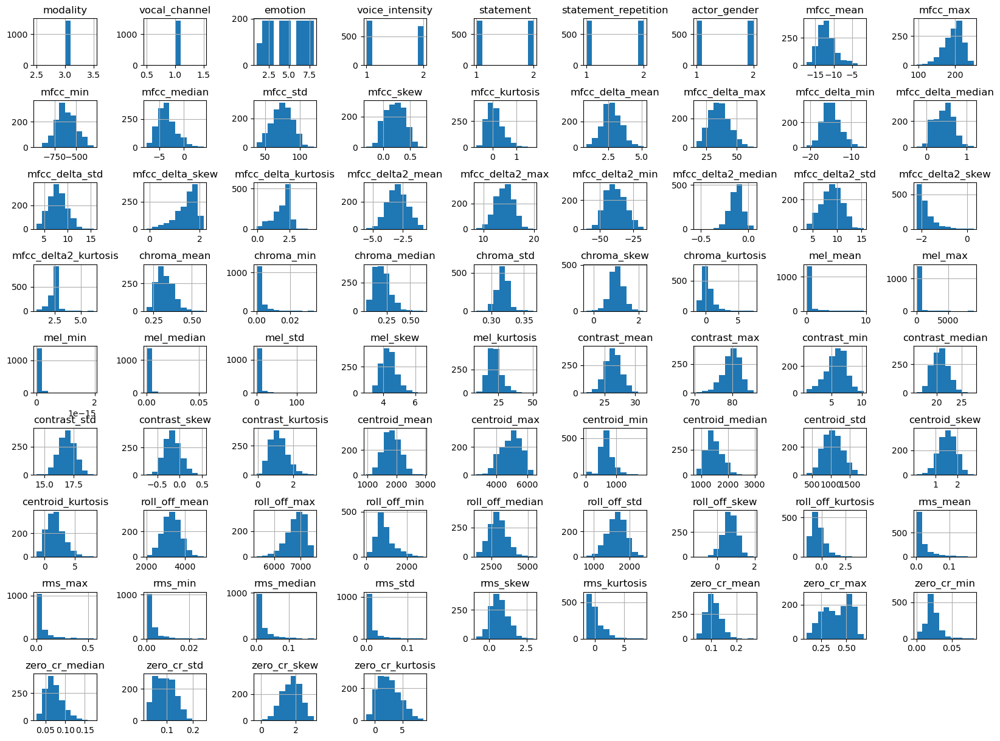

In [5]:
df.hist(figsize=(20,15))
plt.subplots_adjust(hspace=0.75, wspace=0.75);

## Investigating relationships with pairplot<a id='Investigating_relationships_with_pairplot'></a>

* [Contents](#Contents)

### Note: due to limitations in github's file size, pairplots were removed for median, standard deviation, skew and kurtosis.

In [6]:
df.columns

Index(['filename', 'modality', 'vocal_channel', 'emotion', 'voice_intensity',
       'statement', 'statement_repetition', 'actor_gender', 'mfcc_mean',
       'mfcc_max', 'mfcc_min', 'mfcc_median', 'mfcc_std', 'mfcc_skew',
       'mfcc_kurtosis', 'mfcc_delta_mean', 'mfcc_delta_max', 'mfcc_delta_min',
       'mfcc_delta_median', 'mfcc_delta_std', 'mfcc_delta_skew',
       'mfcc_delta_kurtosis', 'mfcc_delta2_mean', 'mfcc_delta2_max',
       'mfcc_delta2_min', 'mfcc_delta2_median', 'mfcc_delta2_std',
       'mfcc_delta2_skew', 'mfcc_delta2_kurtosis', 'chroma_mean', 'chroma_min',
       'chroma_median', 'chroma_std', 'chroma_skew', 'chroma_kurtosis',
       'mel_mean', 'mel_max', 'mel_min', 'mel_median', 'mel_std', 'mel_skew',
       'mel_kurtosis', 'contrast_mean', 'contrast_max', 'contrast_min',
       'contrast_median', 'contrast_std', 'contrast_skew', 'contrast_kurtosis',
       'centroid_mean', 'centroid_max', 'centroid_min', 'centroid_median',
       'centroid_std', 'centroid_skew', '

### Mean pairplots<a id='Mean_pairplots'></a>

* [Contents](#Contents)

In [7]:
mean_pair_df = df.drop(['filename', 'modality', 'vocal_channel', 'voice_intensity',
       'statement', 'statement_repetition', 'actor_gender',
       'mfcc_max', 'mfcc_min', 'mfcc_median', 'mfcc_std', 'mfcc_skew',
       'mfcc_kurtosis', 'mfcc_delta_max', 'mfcc_delta_min',
       'mfcc_delta_median', 'mfcc_delta_std', 'mfcc_delta_skew',
       'mfcc_delta_kurtosis', 'mfcc_delta2_max',
       'mfcc_delta2_min', 'mfcc_delta2_median', 'mfcc_delta2_std',
       'mfcc_delta2_skew', 'mfcc_delta2_kurtosis', 'chroma_min',
       'chroma_median', 'chroma_std', 'chroma_skew',
       'chroma_kurtosis', 'mel_max', 'mel_min', 'mel_median',
       'mel_std', 'mel_skew', 'mel_kurtosis', 'contrast_max',
       'contrast_min', 'contrast_median', 'contrast_std', 'contrast_skew',
       'contrast_kurtosis', 'centroid_max', 'centroid_min',
       'centroid_median', 'centroid_std', 'centroid_skew', 'centroid_kurtosis',
       'roll_off_max', 'roll_off_min', 'roll_off_median',
       'roll_off_std', 'roll_off_skew', 'roll_off_kurtosis',
       'rms_max', 'rms_min', 'rms_median', 'rms_std', 'rms_skew',
       'rms_kurtosis', 'zero_cr_max', 'zero_cr_min',
       'zero_cr_median', 'zero_cr_std', 'zero_cr_skew', 'zero_cr_kurtosis'], axis=1)

mean_pair_df['emotion'].replace({1: 'neutral', 2: 'calm', 3: 'happy', 4: 'sad', 5: 'angry', 6: 'fearful', 
                               7: 'disgust', 8: 'surprised'}, inplace=True)

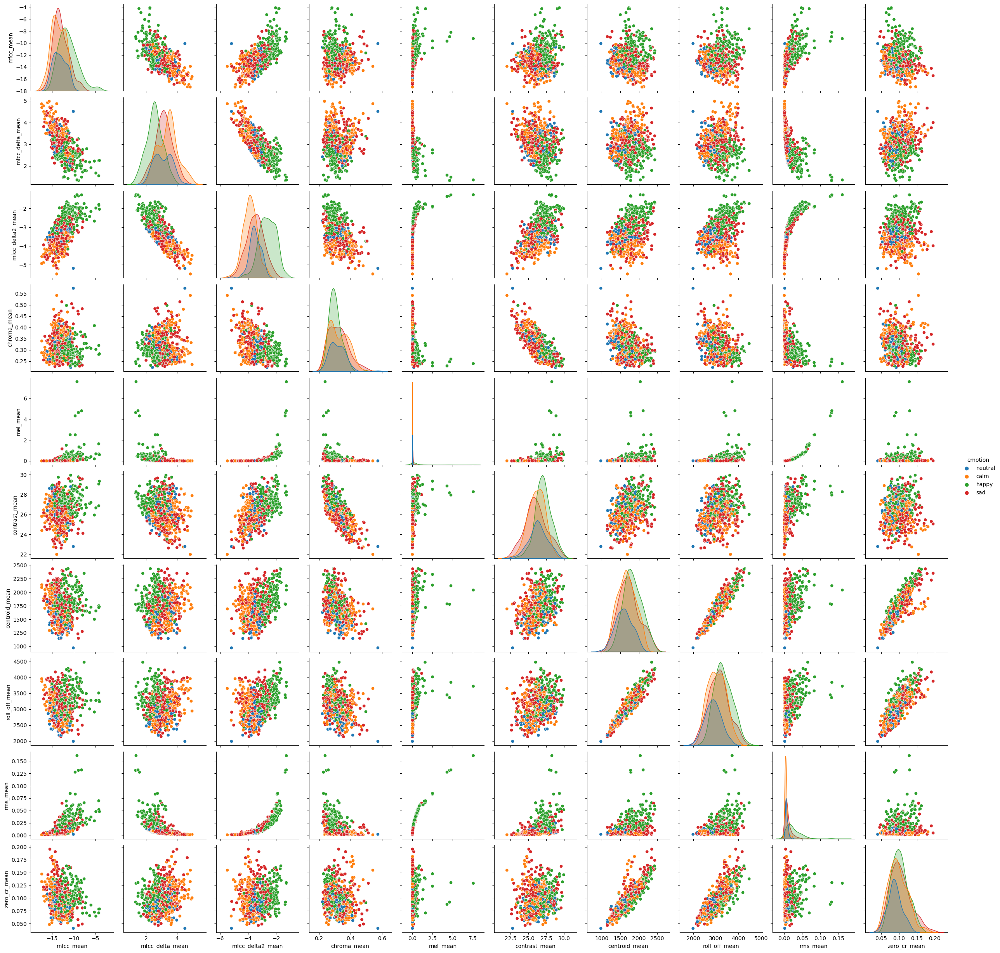

In [8]:
# Neutral, calm, happy, and sad mean comparison
mean_neutral_calm_happy_sad = mean_pair_df[(mean_pair_df['emotion'] == 'neutral') | (mean_pair_df['emotion'] == 'calm') | 
                                         (mean_pair_df['emotion'] == 'happy') | (mean_pair_df['emotion'] == 'sad')]

sns.pairplot(mean_neutral_calm_happy_sad, hue='emotion')
plt.show()

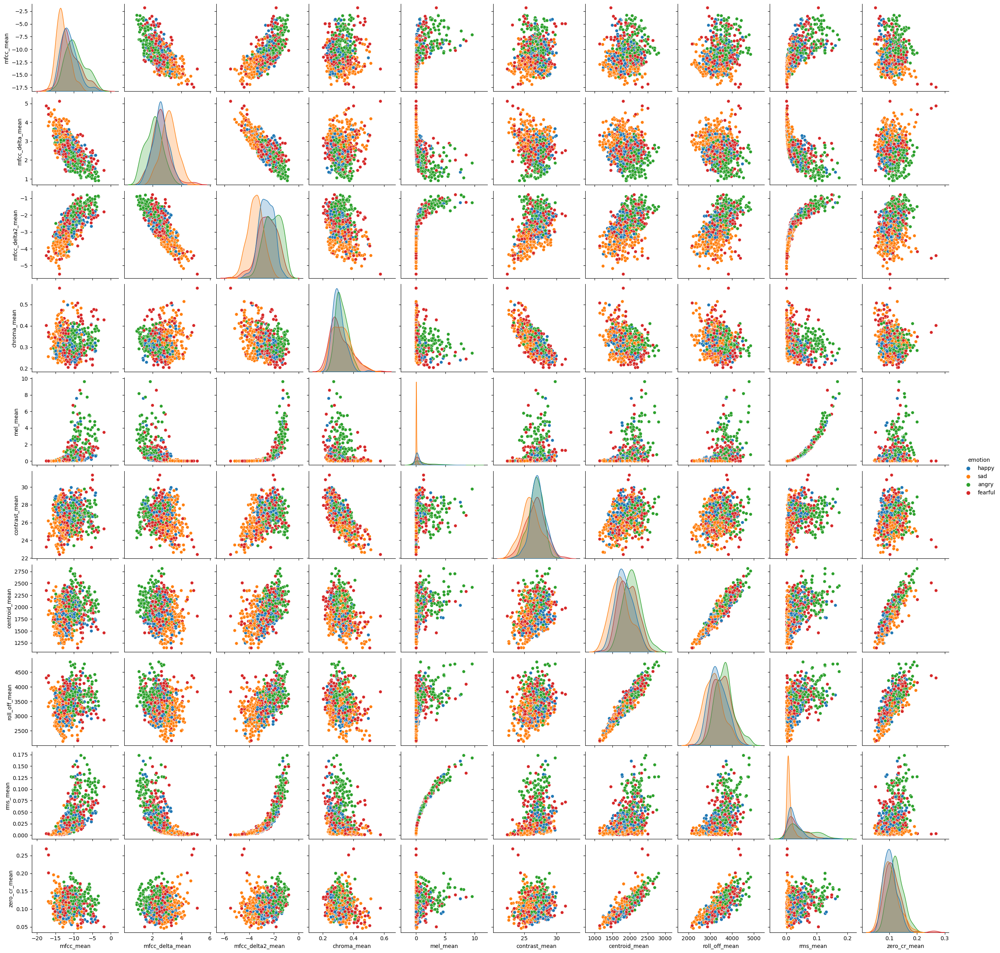

In [9]:
# Happy, sad, angry, and fearful mean comparison
mean_happy_sad_angry_fearful = mean_pair_df[(mean_pair_df['emotion'] == 'happy') | (mean_pair_df['emotion'] == 'sad') | 
                                                    (mean_pair_df['emotion'] == 'angry') | (mean_pair_df['emotion'] == 'fearful')]

sns.pairplot(mean_happy_sad_angry_fearful, hue='emotion')
plt.show()

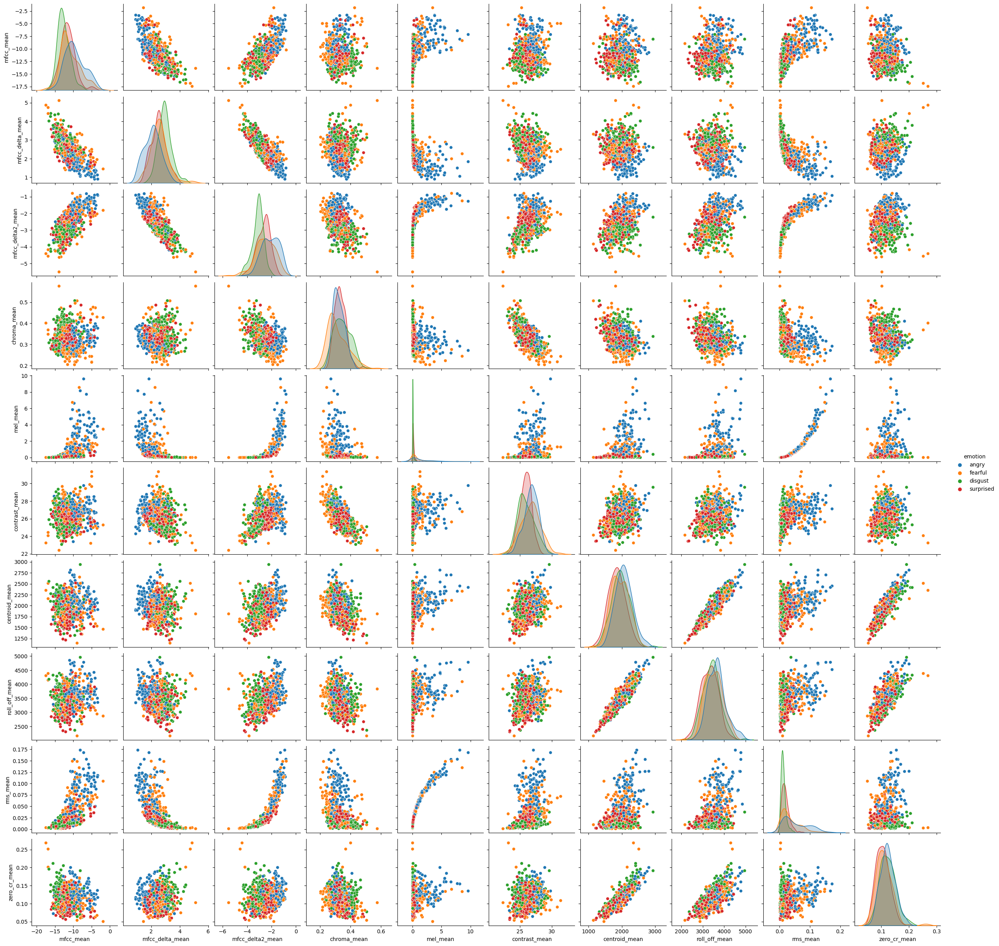

In [10]:
# Angry, fearful, disgust, and surprised mean comparison
mean_angry_fearful_disgust_surprised = mean_pair_df[(mean_pair_df['emotion'] == 'angry') | (mean_pair_df['emotion'] == 'fearful') | 
                                             (mean_pair_df['emotion'] == 'disgust') | (mean_pair_df['emotion'] == 'surprised')]

sns.pairplot(mean_angry_fearful_disgust_surprised, hue='emotion')
plt.show()

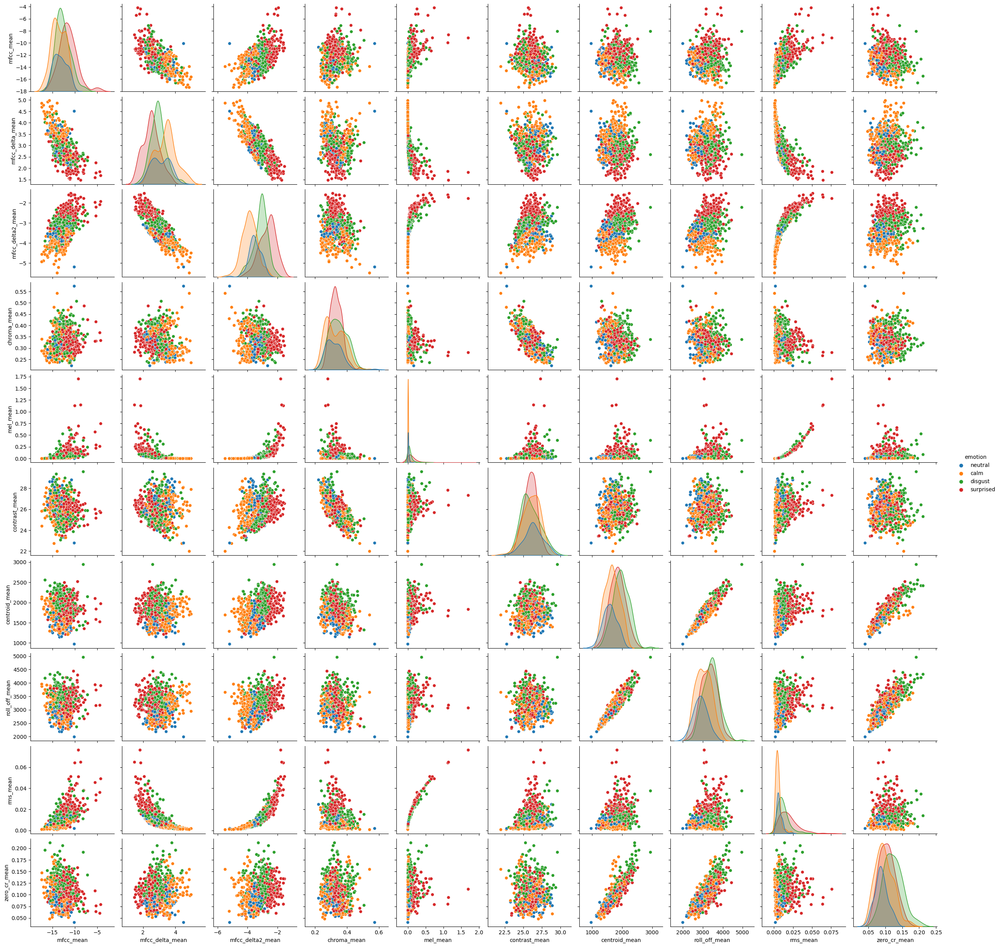

In [11]:
# Disgust, surprised, neutral, and calm mean comparison
mean_disgust_surprised_neutral_calm = mean_pair_df[(mean_pair_df['emotion'] == 'disgust') | (mean_pair_df['emotion'] == 'surprised') | 
                                             (mean_pair_df['emotion'] == 'neutral') | (mean_pair_df['emotion'] == 'calm')]

sns.pairplot(mean_disgust_surprised_neutral_calm, hue='emotion')
plt.show()

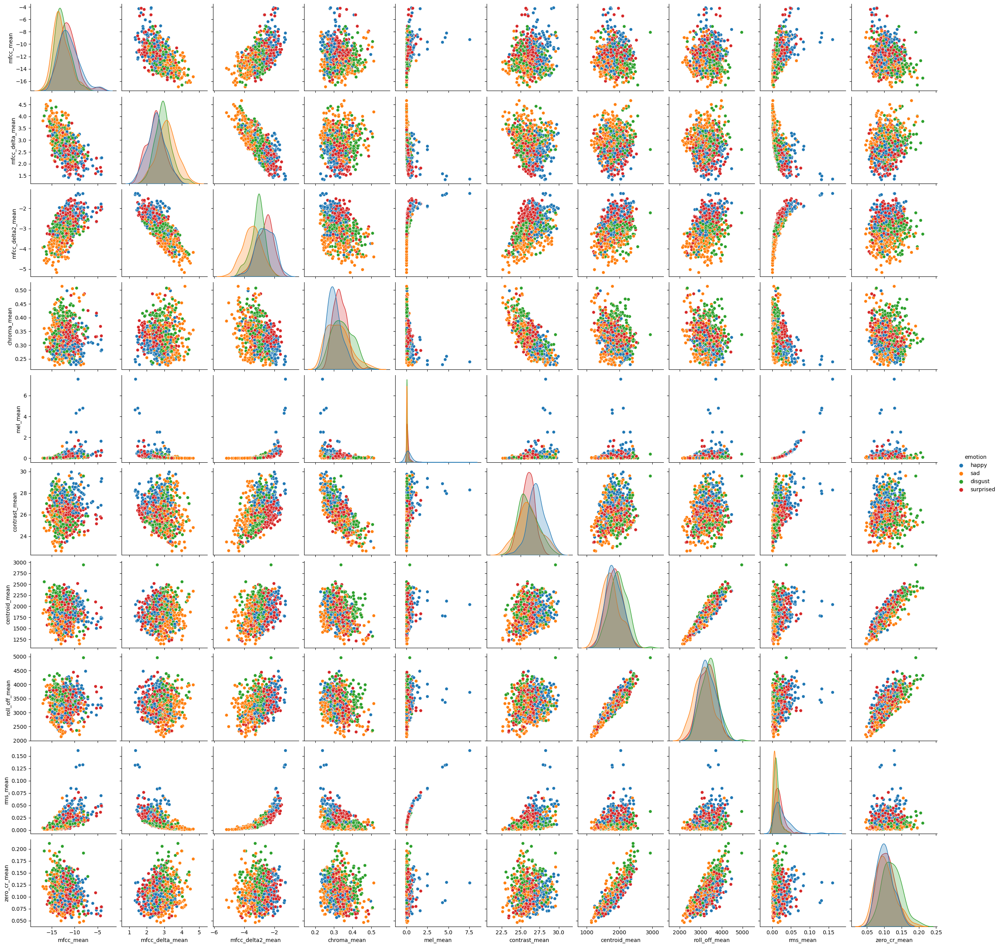

In [12]:
# Happy, sad, digust, and surprised mean comparison
mean_happy_sad_disgust_surprised = mean_pair_df[(mean_pair_df['emotion'] == 'happy') | (mean_pair_df['emotion'] == 'sad') | 
                                             (mean_pair_df['emotion'] == 'disgust') | (mean_pair_df['emotion'] == 'surprised')]

sns.pairplot(mean_happy_sad_disgust_surprised, hue='emotion')
plt.show()

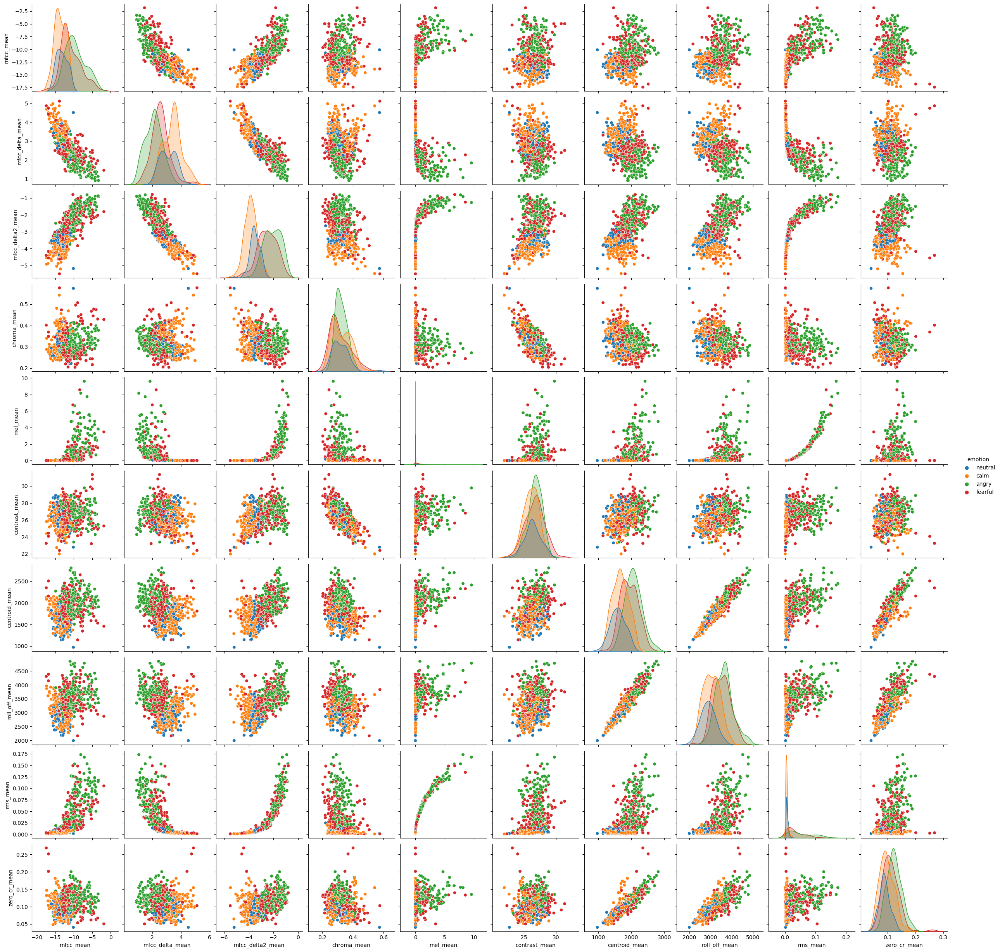

In [13]:
# Neutral, calm, angry, and fearful mean comparison
mean_neutral_calm_angry_fearful = mean_pair_df[(mean_pair_df['emotion'] == 'neutral') | (mean_pair_df['emotion'] == 'calm') | 
                                             (mean_pair_df['emotion'] == 'angry') | (mean_pair_df['emotion'] == 'fearful')]

sns.pairplot(mean_neutral_calm_angry_fearful, hue='emotion')
plt.show()

# Exploring features with models<a id='Exploring_features_with_models'></a>

* [Contents](#Contents)

## Random Forest with RAVDESS<a id='Random_Forest_with_RAVDESS'></a>

* [Contents](#Contents)

In [2]:
data1 = pd.read_csv('voice_data_dw.csv')    # RAVDESS data, dw = data wrangling
data2 = pd.read_csv('voice_data_dw_c.csv')     # CREMA-D data
data3 = pd.read_csv('voice_data_dw_t.csv')     # CREMA-D data
df = pd.DataFrame(data1)
df_c = pd.DataFrame(data2)
df_t = pd.DataFrame(data3)
pd.set_option('display.max_columns', None)
df.head()

,filename,modality,vocal_channel,emotion,voice_intensity,statement,statement_repetition,actor_gender,mfcc_mean,mfcc_max,mfcc_min,mfcc_median,mfcc_std,mfcc_skew,mfcc_kurtosis,mfcc_delta_mean,mfcc_delta_max,mfcc_delta_min,mfcc_delta_median,mfcc_delta_std,mfcc_delta_skew,mfcc_delta_kurtosis,mfcc_delta2_mean,mfcc_delta2_max,mfcc_delta2_min,mfcc_delta2_median,mfcc_delta2_std,mfcc_delta2_skew,mfcc_delta2_kurtosis,chroma_mean,chroma_min,chroma_max,chroma_median,chroma_std,chroma_skew,chroma_kurtosis,mel_mean,mel_max,mel_min,mel_median,mel_std,mel_skew,mel_kurtosis,contrast_mean,contrast_max,contrast_min,contrast_median,contrast_std,contrast_skew,contrast_kurtosis,centroid_mean,centroid_max,centroid_min,centroid_median,centroid_std,centroid_skew,centroid_kurtosis,roll_off_mean,roll_off_max,roll_off_min,roll_off_median,roll_off_std,roll_off_skew,roll_off_kurtosis,rms_mean,rms_max,rms_min,rms_median,rms_std,rms_skew,rms_kurtosis,zero_cr_mean,zero_cr_max,zero_cr_min,zero_cr_median,zero_cr_std,zero_cr_skew,zero_cr_kurtosis
0,03-01-01-01-01-01-01.wav,3,1,1,1,1,1,1,-16.392443,202.98502,-645.92170,-7.125899,82.844154,0.365277,0.181984,3.290076,36.87685,-15.079271,0.568462,8.395280,1.881931,2.384150,-2.929066,16.196424,-35.155490,-0.093855,9.038805,-1.890271,2.538881,0.607089,0.141472,1.0,0.600354,0.236534,0.086949,-0.952044,0.007324,1.707622,1.860741e-18,0.000056,0.045920,3.904024,16.927513,24.848774,81.737506,4.558243,18.060076,19.179764,-0.332873,0.920353,2862.926393,7495.930442,1162.137023,2306.370804,1505.855829,1.652513,1.915730,5278.790509,11923.828125,1998.046875,4651.367188,2714.027774,0.948544,-0.035782,0.005870,0.012585,0.001015,0.005574,0.002752,0.523488,-0.223807,0.071506,0.208984,0.023438,0.046875,0.049214,1.349598,0.792986
1,03-01-01-01-01-02-01.wav,3,1,1,1,1,2,1,-16.195488,193.51984,-644.16350,-6.892159,83.358950,0.258790,-0.088001,3.281766,36.88804,-14.507144,0.626492,8.581219,1.857355,2.298338,-3.001566,15.750255,-34.858368,-0.140539,9.143971,-1.889248,2.497091,0.565118,0.135088,1.0,0.526963,0.247438,0.231975,-0.966832,0.008445,1.459130,1.702563e-18,0.000053,0.052460,3.737249,15.052235,25.445381,81.394861,5.744724,18.907480,19.201790,0.101690,2.415374,2856.267937,7574.012464,1196.255587,2532.671446,1438.028687,1.745676,2.597192,5509.765625,11837.890625,2041.015625,5156.250000,2578.736315,0.814459,0.048691,0.006225,0.013047,0.001003,0.005672,0.003002,0.472005,-0.447499,0.063912,0.183105,0.019531,0.048340,0.042300,1.347601,0.843776
2,03-01-01-01-02-01-01.wav,3,1,1,1,2,1,1,-15.760641,209.64243,-599.33685,-6.811954,80.973440,0.349635,-0.079561,3.183938,33.61964,-16.218931,0.521331,8.188260,1.812531,2.258523,-2.733035,16.290403,-33.561646,-0.003302,8.798903,-1.845969,2.446758,0.566147,0.085513,1.0,0.543228,0.236025,0.195621,-0.746908,0.011151,1.726585,2.294504e-18,0.000077,0.065326,3.784763,16.238434,25.271402,84.231012,3.335950,18.387247,19.357776,-0.364876,1.243544,3147.076638,9735.443474,1074.722832,2347.152059,2109.463110,1.894945,2.580431,5705.295139,12525.390625,1890.625000,5059.570312,3023.452212,0.877642,-0.247283,0.007237,0.017973,0.001440,0.006281,0.003825,1.126351,0.754771,0.086652,0.424316,0.014648,0.048340,0.091483,2.158822,4.017514
3,03-01-01-01-02-02-01.wav,3,1,1,1,2,2,1,-16.046278,215.37698,-620.35815,-7.427359,81.609146,0.240670,-0.124088,3.185494,34.72454,-14.316382,0.496043,8.297734,1.826856,2.279578,-2.840508,17.101452,-35.499820,-0.068866,8.946567,-1.873974,2.477692,0.605738,0.112530,1.0,0.586911,0.229687,0.158463,-0.645343,0.010260,1.904755,2.764673e-18,0.000067,0.061361,3.518846,13.859685,25.348465,82.521337,4.348983,19.184102,19.175904,-0.306959,0.998655,3128.884756,9390.101251,1315.933093,2504.069840,2070.285142,1.732141,1.991167,5710.712139,12482.421875,1847.656250,5134.765625,3071.179190,0.797591,-0.433007,0.006781,0.018386,0.001300,0.005872,0.004013,1.583204,1.841371,0.088229,0.406250,0.013184,0.047852,0.093873,1.803562,2.245144
4,03-01-02-01-01-01-01.wav,3,1,2,1,1,1,1,-16.582544,205.08063,-692.11237,-

In [3]:
def emotion_to_string(e):
    if e % 8 == 1:
        return 'neutral'
    elif e % 8 == 2:
        return 'calm'
    elif e % 8 == 3:
        return 'happy'
    elif e % 8 == 4:
        return 'sad'
    elif e % 8 == 5:
        return 'angry'
    elif e % 8 == 6:
        return 'fearful'
    elif e % 8 == 7:
        return 'disgust'
    else:
        return 'surprised'

# Applying the function to the 'emotion' column
df['emotion'] = df['emotion'].apply(emotion_to_string)

In [4]:
# defining feature list
feature_list = df.columns[8:]

In [5]:
# Dividing dataset into genders
df_male = df[df['actor_gender'] == 1]
df_female = df[df['actor_gender'] == 2]

# Removing 'neutral' category due to imbalance of data and similarity to calm
df_male = df_male[df_male['emotion'] != 'neutral']
df_female = df_female[df_female['emotion'] != 'neutral']

# Features and labels for male dataset
X_male = df_male[feature_list].values
y_male = df_male['emotion'].values

# Features and labels for female dataset
X_female = df_female[feature_list].values
y_female = df_female['emotion'].values

# Splitting the male dataset
X_train_male, X_test_male, y_train_male, y_test_male = train_test_split(
    X_male, y_male, test_size=0.25, random_state=42, shuffle=True, stratify=y_male)

# Splitting the female dataset
X_train_female, X_test_female, y_train_female, y_test_female = train_test_split(
    X_female, y_female, test_size=0.25, random_state=42, shuffle=True, stratify=y_female)

# Initialize scalers for male and female datasets
scaler_male = StandardScaler()
scaler_female = StandardScaler()

# Scale the male datasets
X_train_m_sc = scaler_male.fit_transform(X_train_male)
X_test_m_sc = scaler_male.transform(X_test_male)

# Scale the female datasets
X_train_f_sc = scaler_female.fit_transform(X_train_female)
X_test_f_sc = scaler_female.transform(X_test_female)

print("Male Dataset:", X_train_m_sc.shape, X_test_m_sc.shape, y_train_male.shape, y_test_male.shape)
print("Female Dataset:", X_train_f_sc.shape, X_test_f_sc.shape, y_train_female.shape, y_test_female.shape)

Male Dataset: (504, 70) (168, 70) (504,) (168,)
Female Dataset: (504, 70) (168, 70) (504,) (168,)


In [6]:
# Training male dataset
# best accuracy result: Male: 0                   Female: 0
#                       Male scaled: 0.6011904761904762, Female scaled: 0.5833333333333334
# model_m_sc = RandomForestClassifier(criterion='entropy', max_depth=15, max_features=69, min_samples_leaf=5, 
#                                     min_samples_split=5, n_estimators=1000, n_jobs=-1, random_state=42, warm_start=True, 
#                                     min_weight_fraction_leaf=0.0)
# model_f_sc = RandomForestClassifier(criterion='entropy', max_depth=15, max_features=69, min_samples_leaf=5, 
#                                     min_samples_split=5, n_estimators=1000, n_jobs=-1, random_state=42, warm_start=True, 
#                                     min_weight_fraction_leaf=0.0)

model_male = RandomForestClassifier(criterion='entropy', max_depth=15, max_features=69, min_samples_leaf=5, 
                                    min_samples_split=5, n_estimators=1000, n_jobs=-1, random_state=42, warm_start=True, 
                                    min_weight_fraction_leaf=0.0)

model_female = RandomForestClassifier(criterion='entropy', max_depth=15, max_features=69, min_samples_leaf=5, 
                                    min_samples_split=5, n_estimators=1000, n_jobs=-1, random_state=42, warm_start=True, 
                                    min_weight_fraction_leaf=0.0)

model_m_sc = RandomForestClassifier(criterion='entropy', max_depth=15, max_features=69, min_samples_leaf=5, 
                                    min_samples_split=5, n_estimators=1000, n_jobs=-1, random_state=42, warm_start=True, 
                                    min_weight_fraction_leaf=0.0)

model_f_sc = RandomForestClassifier(criterion='entropy', max_depth=15, max_features=69, min_samples_leaf=5, 
                                    min_samples_split=5, n_estimators=1000, n_jobs=-1, random_state=42, warm_start=True, 
                                    min_weight_fraction_leaf=0.0)

model_male.fit(X_train_male, y_train_male)
model_female.fit(X_train_female, y_train_female)
model_m_sc.fit(X_train_m_sc, y_train_male)
model_f_sc.fit(X_train_f_sc, y_train_female)

RandomForestClassifier(criterion='entropy', max_depth=15, max_features=69,
                       min_samples_leaf=5, min_samples_split=5,
                       n_estimators=1000, n_jobs=-1, random_state=42,
                       warm_start=True)

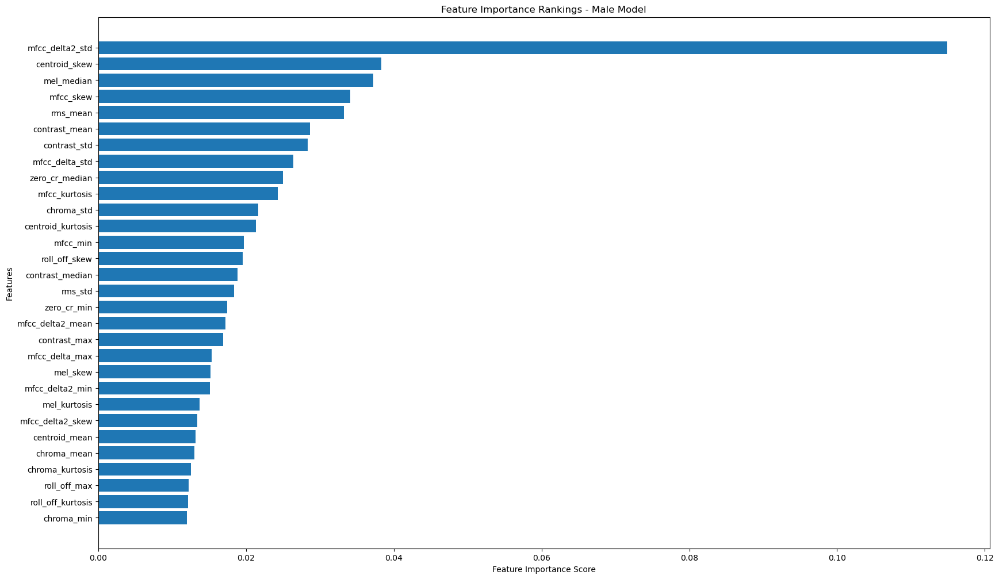

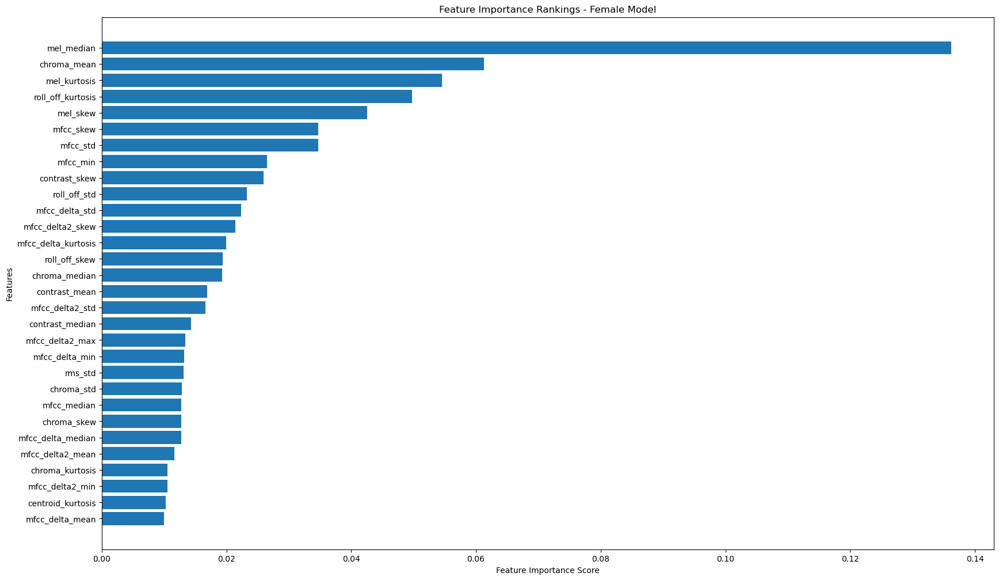

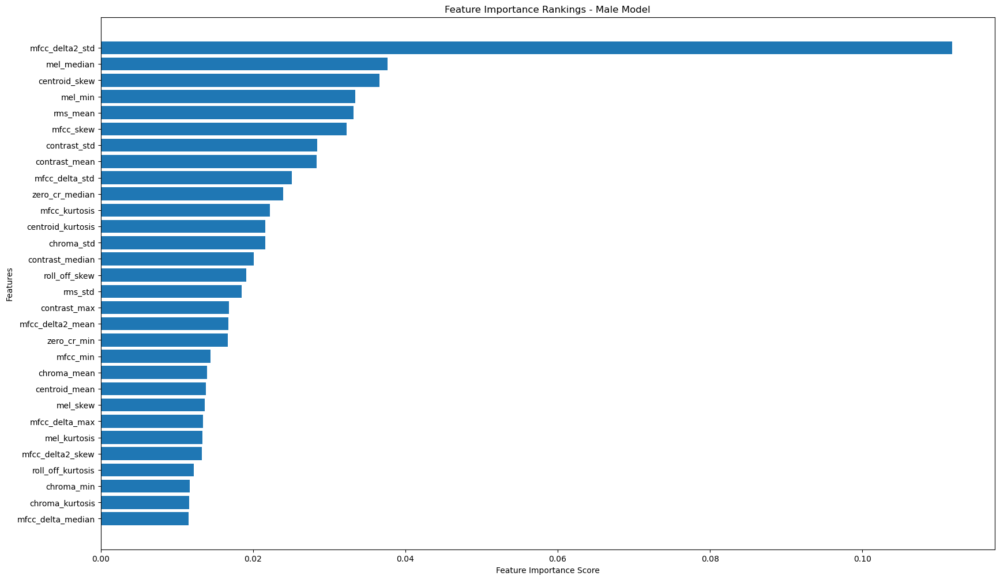

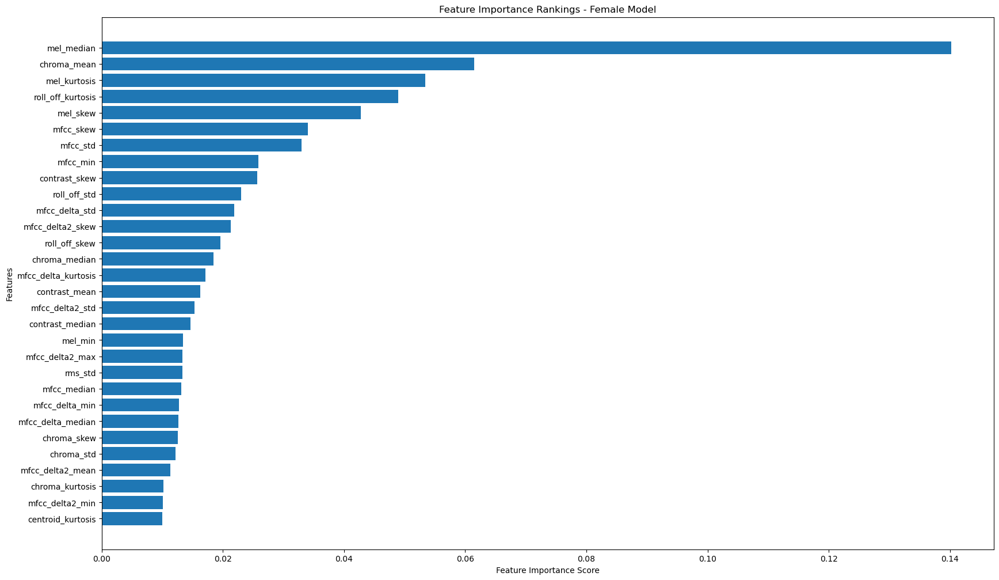

In [7]:
# 'model_male' and 'model_female' are the trained Random Forest models
feature_importances_male = model_male.feature_importances_
feature_importances_female = model_female.feature_importances_
feature_importances_m_sc = model_m_sc.feature_importances_
feature_importances_f_sc = model_f_sc.feature_importances_

# Update this list to match the features used in your current model
feature_names_m = feature_list
feature_names_f = feature_list

# Creating dictionaries to map feature names to their importances for each model
importances_male = dict(zip(feature_names_m, feature_importances_male))
importances_female = dict(zip(feature_names_f, feature_importances_female))
importances_m_sc = dict(zip(feature_names_m, feature_importances_m_sc))
importances_f_sc = dict(zip(feature_names_f, feature_importances_f_sc))

# Function to plot feature importances and return top 30 features
def plot_feature_importances_and_get_top_30(importances, title):
    # Sort features by importance
    sorted_importances = sorted(importances.items(), key=lambda x: x[1], reverse=True)

    # Extract feature names and scores
    sorted_features = [x[0] for x in sorted_importances]
    sorted_scores = [x[1] for x in sorted_importances]

    # Plot
    plt.figure(figsize=(20, 12))
    plt.barh(sorted_features[:30], sorted_scores[:30])  # Plot only top 20 features
    plt.xlabel('Feature Importance Score')
    plt.ylabel('Features')
    plt.title(title)
    plt.gca().invert_yaxis()
    plt.show()

    # Return top 30 features
    return sorted_features[:30]

# Get and plot top 30 features for male model
top_30_features_male = plot_feature_importances_and_get_top_30(importances_male, 'Feature Importance Rankings - Male Model')

# Get and plot top 30 features for female model
top_30_features_female = plot_feature_importances_and_get_top_30(importances_female, 'Feature Importance Rankings - Female Model')

# Get and plot top 30 features for scaled male model
top_30_features_m_sc = plot_feature_importances_and_get_top_30(importances_m_sc, 'Feature Importance Rankings - Male Model')

# Get and plot top 30 features for scaled female model
top_30_features_f_sc = plot_feature_importances_and_get_top_30(importances_f_sc, 'Feature Importance Rankings - Female Model')

### Random Forest results<a id='Random_Forest_results'></a>

* [Contents](#Contents)

In [8]:
# Predict on the test set
y_pred_male = model_male.predict(X_test_male)
y_pred_female = model_female.predict(X_test_female)
y_pred_m_sc = model_m_sc.predict(X_test_m_sc)
y_pred_f_sc = model_f_sc.predict(X_test_f_sc)

In [9]:
# Evaluate the models
accuracy_male = accuracy_score(y_test_male, y_pred_male)
accuracy_female = accuracy_score(y_test_female, y_pred_female)
accuracy_m_sc = accuracy_score(y_test_male, y_pred_m_sc)
accuracy_f_sc = accuracy_score(y_test_female, y_pred_f_sc)

print(confusion_matrix(y_test_male, y_pred_male))
print(classification_report(y_test_male, y_pred_male))
print(f"Accuracy for Male Model: {accuracy_male}")
print()
print()
print(confusion_matrix(y_test_female, y_pred_female))
print(classification_report(y_test_female, y_pred_female))
print(f"Accuracy for Female Model: {accuracy_female}")
print()
print()
print(confusion_matrix(y_test_male, y_pred_m_sc))
print(classification_report(y_test_male, y_pred_m_sc))
print(f"Accuracy for scaled Male Model: {accuracy_m_sc}")
print()
print()
print(confusion_matrix(y_test_female, y_pred_f_sc))
print(classification_report(y_test_female, y_pred_f_sc))
print(f"Accuracy for scaled Female Model: {accuracy_f_sc}")

[[20  0  0  0  2  1  1]
 [ 0 20  0  0  2  2  0]
 [ 0  1 20  0  0  0  3]
 [ 3  0  1  9  4  3  4]
 [ 3  1  1  2  6  2  9]
 [ 0  8  0  1  6  9  0]
 [ 1  3  3  0  1  2 14]]
              precision    recall  f1-score   support

       angry       0.74      0.83      0.78        24
        calm       0.61      0.83      0.70        24
     disgust       0.80      0.83      0.82        24
     fearful       0.75      0.38      0.50        24
       happy       0.29      0.25      0.27        24
         sad       0.47      0.38      0.42        24
   surprised       0.45      0.58      0.51        24

    accuracy                           0.58       168
   macro avg       0.59      0.58      0.57       168
weighted avg       0.59      0.58      0.57       168

Accuracy for Male Model: 0.5833333333333334


[[16  0  3  2  1  0  2]
 [ 0 19  1  2  0  1  1]
 [ 2  2 15  1  0  1  3]
 [ 1  3  1 12  5  2  0]
 [ 8  0  0  4  9  2  1]
 [ 0  8  0  2  3 11  0]
 [ 2  1  1  5  1  1 13]]
              preci

## Gradient Boosting with RAVDESS<a id='Gradient_Boosting_with_RAVDESS'></a>

* [Contents](#Contents)

In [2]:
data1 = pd.read_csv('voice_data_dw.csv')    # RAVDESS data, dw = data wrangling
data2 = pd.read_csv('voice_data_dw_c.csv')     # CREMA-D data
data3 = pd.read_csv('voice_data_dw_t.csv')     # CREMA-D data
df = pd.DataFrame(data1)
df_c = pd.DataFrame(data2)
df_t = pd.DataFrame(data3)
pd.set_option('display.max_columns', None)
df.head()

,filename,modality,vocal_channel,emotion,voice_intensity,statement,statement_repetition,actor_gender,mfcc_mean,mfcc_max,mfcc_min,mfcc_median,mfcc_std,mfcc_skew,mfcc_kurtosis,mfcc_delta_mean,mfcc_delta_max,mfcc_delta_min,mfcc_delta_median,mfcc_delta_std,mfcc_delta_skew,mfcc_delta_kurtosis,mfcc_delta2_mean,mfcc_delta2_max,mfcc_delta2_min,mfcc_delta2_median,mfcc_delta2_std,mfcc_delta2_skew,mfcc_delta2_kurtosis,chroma_mean,chroma_min,chroma_max,chroma_median,chroma_std,chroma_skew,chroma_kurtosis,mel_mean,mel_max,mel_min,mel_median,mel_std,mel_skew,mel_kurtosis,contrast_mean,contrast_max,contrast_min,contrast_median,contrast_std,contrast_skew,contrast_kurtosis,centroid_mean,centroid_max,centroid_min,centroid_median,centroid_std,centroid_skew,centroid_kurtosis,roll_off_mean,roll_off_max,roll_off_min,roll_off_median,roll_off_std,roll_off_skew,roll_off_kurtosis,rms_mean,rms_max,rms_min,rms_median,rms_std,rms_skew,rms_kurtosis,zero_cr_mean,zero_cr_max,zero_cr_min,zero_cr_median,zero_cr_std,zero_cr_skew,zero_cr_kurtosis
0,03-01-01-01-01-01-01.wav,3,1,1,1,1,1,1,-16.392443,202.98502,-645.92170,-7.125899,82.844154,0.365277,0.181984,3.290076,36.87685,-15.079271,0.568462,8.395280,1.881931,2.384150,-2.929066,16.196424,-35.155490,-0.093855,9.038805,-1.890271,2.538881,0.607089,0.141472,1.0,0.600354,0.236534,0.086949,-0.952044,0.007324,1.707622,1.860741e-18,0.000056,0.045920,3.904024,16.927513,24.848774,81.737506,4.558243,18.060076,19.179764,-0.332873,0.920353,2862.926393,7495.930442,1162.137023,2306.370804,1505.855829,1.652513,1.915730,5278.790509,11923.828125,1998.046875,4651.367188,2714.027774,0.948544,-0.035782,0.005870,0.012585,0.001015,0.005574,0.002752,0.523488,-0.223807,0.071506,0.208984,0.023438,0.046875,0.049214,1.349598,0.792986
1,03-01-01-01-01-02-01.wav,3,1,1,1,1,2,1,-16.195488,193.51984,-644.16350,-6.892159,83.358950,0.258790,-0.088001,3.281766,36.88804,-14.507144,0.626492,8.581219,1.857355,2.298338,-3.001566,15.750255,-34.858368,-0.140539,9.143971,-1.889248,2.497091,0.565118,0.135088,1.0,0.526963,0.247438,0.231975,-0.966832,0.008445,1.459130,1.702563e-18,0.000053,0.052460,3.737249,15.052235,25.445381,81.394861,5.744724,18.907480,19.201790,0.101690,2.415374,2856.267937,7574.012464,1196.255587,2532.671446,1438.028687,1.745676,2.597192,5509.765625,11837.890625,2041.015625,5156.250000,2578.736315,0.814459,0.048691,0.006225,0.013047,0.001003,0.005672,0.003002,0.472005,-0.447499,0.063912,0.183105,0.019531,0.048340,0.042300,1.347601,0.843776
2,03-01-01-01-02-01-01.wav,3,1,1,1,2,1,1,-15.760641,209.64243,-599.33685,-6.811954,80.973440,0.349635,-0.079561,3.183938,33.61964,-16.218931,0.521331,8.188260,1.812531,2.258523,-2.733035,16.290403,-33.561646,-0.003302,8.798903,-1.845969,2.446758,0.566147,0.085513,1.0,0.543228,0.236025,0.195621,-0.746908,0.011151,1.726585,2.294504e-18,0.000077,0.065326,3.784763,16.238434,25.271402,84.231012,3.335950,18.387247,19.357776,-0.364876,1.243544,3147.076638,9735.443474,1074.722832,2347.152059,2109.463110,1.894945,2.580431,5705.295139,12525.390625,1890.625000,5059.570312,3023.452212,0.877642,-0.247283,0.007237,0.017973,0.001440,0.006281,0.003825,1.126351,0.754771,0.086652,0.424316,0.014648,0.048340,0.091483,2.158822,4.017514
3,03-01-01-01-02-02-01.wav,3,1,1,1,2,2,1,-16.046278,215.37698,-620.35815,-7.427359,81.609146,0.240670,-0.124088,3.185494,34.72454,-14.316382,0.496043,8.297734,1.826856,2.279578,-2.840508,17.101452,-35.499820,-0.068866,8.946567,-1.873974,2.477692,0.605738,0.112530,1.0,0.586911,0.229687,0.158463,-0.645343,0.010260,1.904755,2.764673e-18,0.000067,0.061361,3.518846,13.859685,25.348465,82.521337,4.348983,19.184102,19.175904,-0.306959,0.998655,3128.884756,9390.101251,1315.933093,2504.069840,2070.285142,1.732141,1.991167,5710.712139,12482.421875,1847.656250,5134.765625,3071.179190,0.797591,-0.433007,0.006781,0.018386,0.001300,0.005872,0.004013,1.583204,1.841371,0.088229,0.406250,0.013184,0.047852,0.093873,1.803562,2.245144
4,03-01-02-01-01-01-01.wav,3,1,2,1,1,1,1,-16.582544,205.08063,-692.11237,-

In [3]:
def emotion_to_string(e):
    if e % 8 == 1:
        return 'neutral'
    elif e % 8 == 2:
        return 'calm'
    elif e % 8 == 3:
        return 'happy'
    elif e % 8 == 4:
        return 'sad'
    elif e % 8 == 5:
        return 'angry'
    elif e % 8 == 6:
        return 'fearful'
    elif e % 8 == 7:
        return 'disgust'
    else:
        return 'surprised'

# Applying the function to the 'emotion' column
df['emotion'] = df['emotion'].apply(emotion_to_string)

In [56]:
df.columns

Index(['filename', 'modality', 'vocal_channel', 'emotion', 'voice_intensity',
       'statement', 'statement_repetition', 'actor_gender', 'mfcc_mean',
       'mfcc_max', 'mfcc_min', 'mfcc_median', 'mfcc_std', 'mfcc_skew',
       'mfcc_kurtosis', 'mfcc_delta_mean', 'mfcc_delta_max', 'mfcc_delta_min',
       'mfcc_delta_median', 'mfcc_delta_std', 'mfcc_delta_skew',
       'mfcc_delta_kurtosis', 'mfcc_delta2_mean', 'mfcc_delta2_max',
       'mfcc_delta2_min', 'mfcc_delta2_median', 'mfcc_delta2_std',
       'mfcc_delta2_skew', 'mfcc_delta2_kurtosis', 'chroma_mean', 'chroma_min',
       'chroma_median', 'chroma_std', 'chroma_skew', 'chroma_kurtosis',
       'mel_mean', 'mel_max', 'mel_min', 'mel_median', 'mel_std', 'mel_skew',
       'mel_kurtosis', 'contrast_mean', 'contrast_max', 'contrast_min',
       'contrast_median', 'contrast_std', 'contrast_skew', 'contrast_kurtosis',
       'centroid_mean', 'centroid_max', 'centroid_min', 'centroid_median',
       'centroid_std', 'centroid_skew', '

In [4]:
feature_list = df.columns[8:]

In [50]:
# Dividing dataset into genders
df_male = df[df['actor_gender'] == 1]
df_female = df[df['actor_gender'] == 2]

# Removing 'neutral' category due to imbalance of data and similarity to calm
df_male = df_male[df_male['emotion'] != 'neutral']
df_female = df_female[df_female['emotion'] != 'neutral']

# Features and labels for male dataset
X_male = df_male[feature_list].values
y_male = df_male['emotion'].values

# Features and labels for female dataset
X_female = df_female[feature_list].values
y_female = df_female['emotion'].values

# Splitting the male dataset
X_train_male, X_test_male, y_train_male, y_test_male = train_test_split(
    X_male, y_male, test_size=0.25, random_state=42, shuffle=True) # stratify=y_male

# Splitting the female dataset
X_train_female, X_test_female, y_train_female, y_test_female = train_test_split(
    X_female, y_female, test_size=0.25, random_state=42, shuffle=True)

# Initialize scalers for male and female datasets
scaler_male = StandardScaler()
scaler_female = StandardScaler()

# Scale the male datasets
X_train_m_sc = scaler_male.fit_transform(X_train_male)
X_test_m_sc = scaler_male.transform(X_test_male)

# Scale the female datasets
X_train_f_sc = scaler_female.fit_transform(X_train_female)
X_test_f_sc = scaler_female.transform(X_test_female)

print("Male Dataset:", X_train_m_sc.shape, X_test_m_sc.shape, y_train_male.shape, y_test_male.shape)
print("Female Dataset:", X_train_f_sc.shape, X_test_f_sc.shape, y_train_female.shape, y_test_female.shape)

Male Dataset: (504, 70) (168, 70) (504,) (168,)
Female Dataset: (504, 70) (168, 70) (504,) (168,)


In [56]:
# Initialize the Gradient Boosting Classifier and train the model
# best result: 0.7142857142857143
# gb_clf_male = GradientBoostingClassifier(max_depth=6, max_features=20, min_samples_leaf=15, min_samples_split=20, 
#                                          n_estimators=500, random_state=42, learning_rate=0.1)

gb_clf_m_sc = GradientBoostingClassifier(max_depth=15, max_features=30, min_samples_leaf=5, min_samples_split=10, 
                                         n_estimators=1000, random_state=42, learning_rate=0.05)

gb_clf_m_sc.fit(X_train_m_sc, y_train_male)

GradientBoostingClassifier(learning_rate=0.05, max_depth=15, max_features=30,
                           min_samples_leaf=5, min_samples_split=10,
                           n_estimators=1000, random_state=42)

In [57]:
# Initialize the Gradient Boosting Classifier and train the model
# best result: 0.7023809523809523
# gb_clf_female = GradientBoostingClassifier(max_depth=4, max_features=20, min_samples_leaf=5, min_samples_split=10, 
#                                            n_estimators=500, learning_rate=0.1, random_state=42)

gb_clf_f_sc = GradientBoostingClassifier(max_depth=4, max_features=20, min_samples_leaf=5, min_samples_split=10, 
                                           n_estimators=500, learning_rate=0.1, random_state=42)

gb_clf_f_sc.fit(X_train_f_sc, y_train_female)

GradientBoostingClassifier(max_depth=4, max_features=20, min_samples_leaf=5,
                           min_samples_split=10, n_estimators=500,
                           random_state=42)

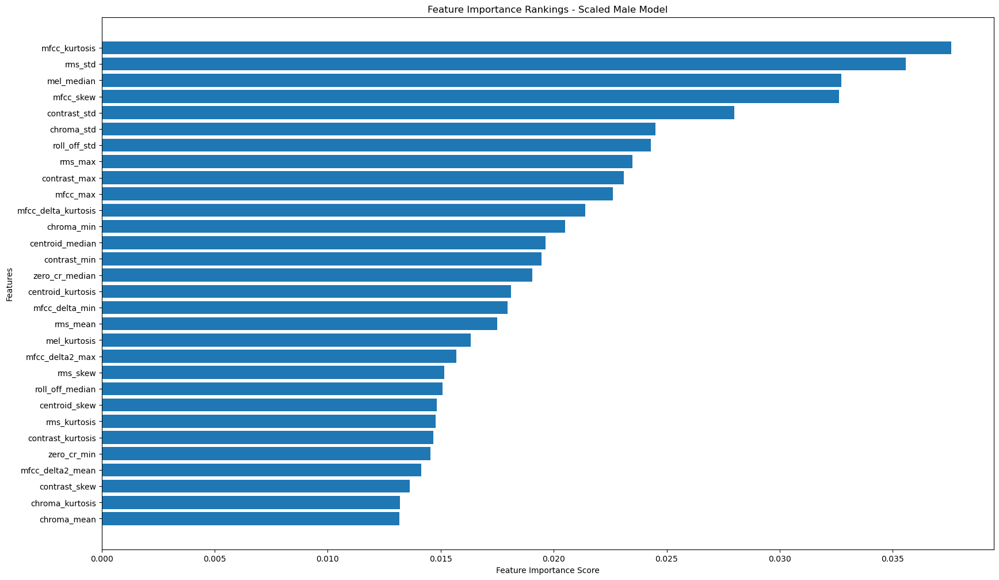

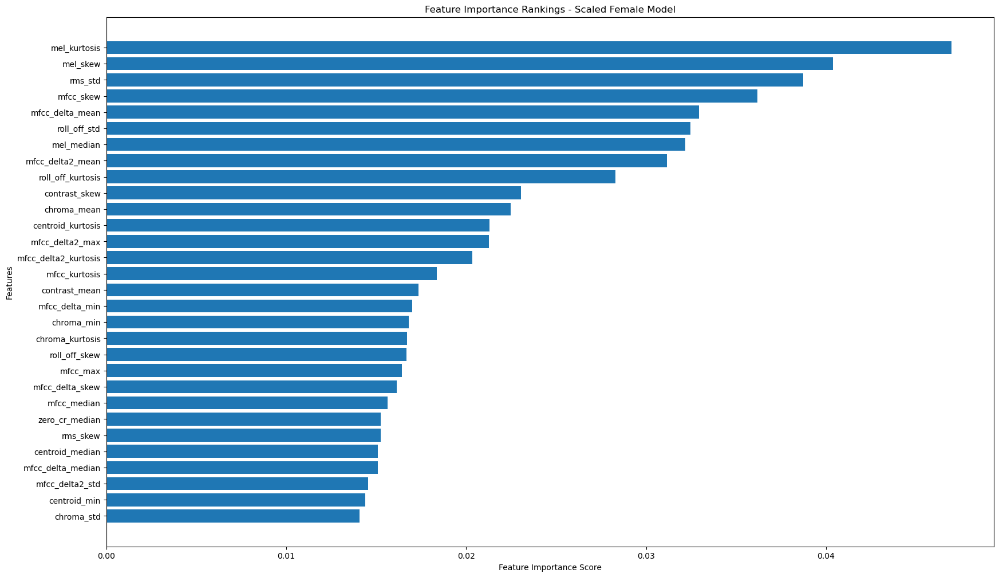

In [58]:
# 'model_male' and 'model_female' are the trained Random Forest models
gb_feature_importances_m_sc = gb_clf_m_sc.feature_importances_
gb_feature_importances_f_sc = gb_clf_f_sc.feature_importances_

# Update this list to match the features used in your current model
gb_feature_names = feature_list

# Creating dictionaries to map feature names to their importances for each model
gb_importances_m_sc = dict(zip(gb_feature_names, gb_feature_importances_m_sc))
gb_importances_f_sc = dict(zip(gb_feature_names, gb_feature_importances_f_sc))

# Function to plot feature importances and return top 30 features
def plot_gb_feature_importances_and_get_top_30(importances, title):
    # Sort features by importance
    gb_sorted_importances = sorted(importances.items(), key=lambda x: x[1], reverse=True)

    # Extract feature names and scores
    gb_sorted_features = [x[0] for x in gb_sorted_importances]
    gb_sorted_scores = [x[1] for x in gb_sorted_importances]

    # Plot
    plt.figure(figsize=(20, 12))
    plt.barh(gb_sorted_features[:30], gb_sorted_scores[:30])  # Plot only top 30 features
    plt.xlabel('Feature Importance Score')
    plt.ylabel('Features')
    plt.title(title)
    plt.gca().invert_yaxis()
    plt.show()

    # Return top 30 features
    return gb_sorted_features[:20]

# Get and plot top 30 features for male model
gb_top_30_features_m_sc = plot_gb_feature_importances_and_get_top_30(gb_importances_m_sc, 'Feature Importance Rankings - Scaled Male Model')

# Get and plot top 30 features for female model
gb_top_30_features_f_sc = plot_gb_feature_importances_and_get_top_30(gb_importances_f_sc, 'Feature Importance Rankings - Scaled Female Model')


### Gradient Boosting results<a id='Gradient_Boosting_results'></a>

* [Contents](#Contents)

In [59]:
# Predict on the test set
y_pred_m_sc = gb_clf_m_sc.predict(X_test_m_sc)
y_pred_f_sc = gb_clf_f_sc.predict(X_test_f_sc)

In [60]:
# Evaluate the models
accuracy_m_sc = accuracy_score(y_test_male, y_pred_m_sc)
accuracy_f_sc = accuracy_score(y_test_female, y_pred_f_sc)

print("\nConfusion Matrix for Male Model:")
print(confusion_matrix(y_test_male, y_pred_m_sc))
print(classification_report(y_test_male, y_pred_m_sc))
print(f"Accuracy for Male Model: {accuracy_m_sc}")
print()
print()
print("\nConfusion Matrix for Female Model:")
print(confusion_matrix(y_test_female, y_pred_f_sc))
print(classification_report(y_test_female, y_pred_f_sc))
print(f"Accuracy for Female Model: {accuracy_f_sc}")


Confusion Matrix for Male Model:
[[17  0  1  2  1  1  3]
 [ 0 16  1  2  1  2  1]
 [ 3  2 21  0  1  0  0]
 [ 2  1  1 13  1  1  1]
 [ 2  2  0  3 13  2  0]
 [ 0  2  3  3  4  9  1]
 [ 1  2  2  4  5  2 13]]
              precision    recall  f1-score   support

       angry       0.68      0.68      0.68        25
        calm       0.64      0.70      0.67        23
     disgust       0.72      0.78      0.75        27
     fearful       0.48      0.65      0.55        20
       happy       0.50      0.59      0.54        22
         sad       0.53      0.41      0.46        22
   surprised       0.68      0.45      0.54        29

    accuracy                           0.61       168
   macro avg       0.61      0.61      0.60       168
weighted avg       0.62      0.61      0.60       168

Accuracy for Male Model: 0.6071428571428571



Confusion Matrix for Female Model:
[[17  0  1  2  2  0  3]
 [ 0 21  1  0  0  1  0]
 [ 1  1 18  0  1  4  2]
 [ 0  0  2 14  1  0  3]
 [ 1  0  0  3 12  3  3

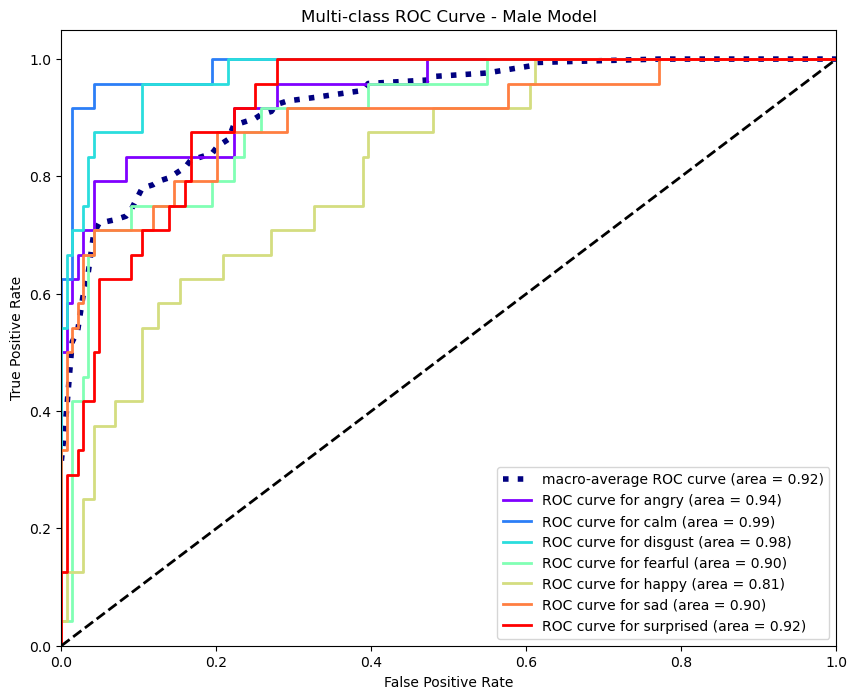

In [65]:
# Define the emotion classes
emotion_classes = gb_clf_male.classes_

# Binarize the labels for the male dataset
y_test_male_binarized = label_binarize(y_test_male, classes=emotion_classes)
n_classes_male = y_test_male_binarized.shape[1]

# Compute ROC curve and ROC area for each class
fpr_male = dict()
tpr_male = dict()
roc_auc_male = dict()

y_prob = gb_clf_male.predict_proba(X_test_m_sc)

for i in range(n_classes_male):
    fpr_male[i], tpr_male[i], _ = roc_curve(y_test_male_binarized[:, i], y_prob[:, i])
    roc_auc_male[i] = auc(fpr_male[i], tpr_male[i])

# Compute micro-average ROC curve and ROC area
fpr_male["micro"], tpr_male["micro"], _ = roc_curve(y_test_male_binarized.ravel(), y_prob.ravel())
roc_auc_male["micro"] = auc(fpr_male["micro"], tpr_male["micro"])

# Aggregate all false positive rates
all_fpr_male = np.unique(np.concatenate([fpr_male[i] for i in range(n_classes_male)]))

# Interpolate all ROC curves at these points
mean_tpr_male = np.zeros_like(all_fpr_male)
for i in range(n_classes_male):
    mean_tpr_male += np.interp(all_fpr_male, fpr_male[i], tpr_male[i])

# Average it and compute AUC
mean_tpr_male /= n_classes_male

fpr_male["macro"] = all_fpr_male
tpr_male["macro"] = mean_tpr_male
roc_auc_male["macro"] = auc(fpr_male["macro"], tpr_male["macro"])

# Plot all ROC curves
plt.figure(figsize=(10, 8))

# Plot macro-average ROC curve
plt.plot(fpr_male["macro"], tpr_male["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'.format(roc_auc_male["macro"]),
         color='navy', linestyle=':', linewidth=4)

# Plot ROC curve for each class
colors = iter(plt.cm.rainbow(np.linspace(0, 1, n_classes_male)))
for i, color in zip(range(n_classes_male), colors):
    plt.plot(fpr_male[i], tpr_male[i], color=color, lw=2,
             label='ROC curve for {0} (area = {1:0.2f})'.format(emotion_classes[i], roc_auc_male[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Multi-class ROC Curve - Male Model')
plt.legend(loc="lower right")
plt.show()

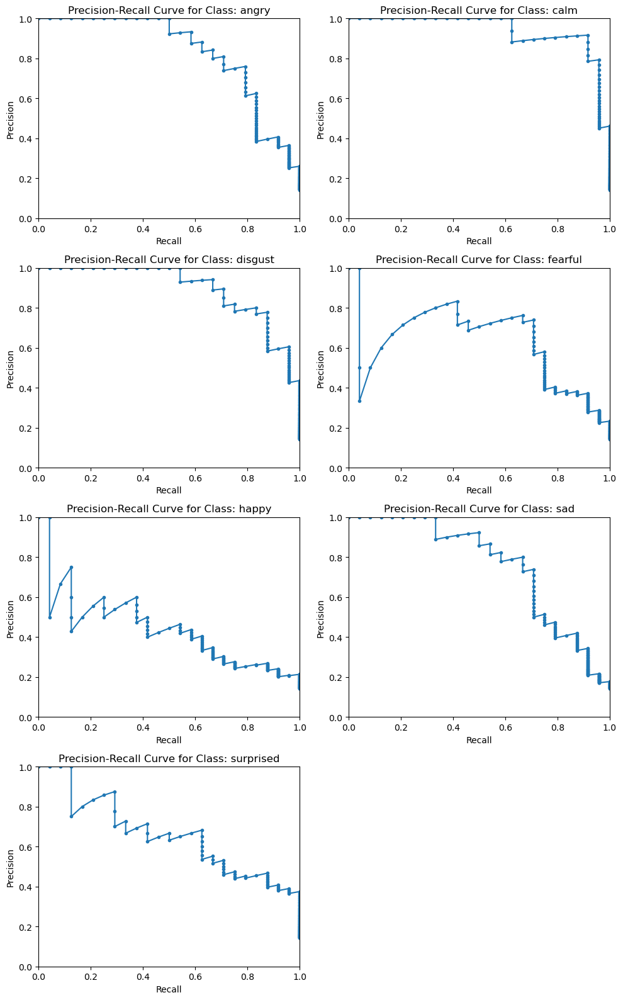

In [68]:
# Assuming 'y_test' is your true labels and 'model' is your trained model
# 'n_classes' is the number of emotion classes
emotion_classes = gb_clf_male.classes_
n_classes = len(emotion_classes)
y_score_m = gb_clf_male.predict_proba(X_test_m_sc)

rows = n_classes // 2 if n_classes % 2 == 0 else (n_classes // 2) + 1

fig, axes = plt.subplots(nrows=rows, ncols=2, figsize=(10, rows * 4))
axes = axes.ravel()

# Hide unused subplots if the number of classes is odd
if n_classes % 2 != 0:
    axes[-1].set_visible(False)

for i in range(n_classes):
    # Convert y_test_male to binary format for the current class
    y_test_binary = np.where(y_test_male == emotion_classes[i], 1, 0)
    
    # Compute precision and recall for each class
    precision, recall, _ = precision_recall_curve(y_test_binary, y_score_m[:, i])
    
    # Plot the precision-recall curve for the class
    axes[i].plot(recall, precision, marker='.')
    axes[i].set_title(f'Precision-Recall Curve for Class: {emotion_classes[i]}')
    axes[i].set_xlabel('Recall')
    axes[i].set_ylabel('Precision')
    axes[i].set_xlim([0, 1])
    axes[i].set_ylim([0, 1])

plt.tight_layout()
plt.show()


# Feature importance<a id='Feature_importance'></a>

Through some initial testing and the pairplots results, there are a few features and statistics that stand out. 
In general the RandomForest and GradientBoosting reveiled that median, std, mean, skew and kurtosis were the most 
helpful statistics. A few others like min and max played a role as well but appeared less requently. After several tests,
GradientBoosting gave better accuracy scores on average than RandomForest. Some of the best features GradientBoosting 
displayed were <span style="color:red">mfcc_delta_median, rms_std, mfcc_delta2_max, contrast_median, and chroma_std</span> for male actors. For female actors 
the top 5 features from GradientBoosting were <span style="color:red">mel_kurtosis, mfcc_skew, rms_std, mel_skew, and roll_off_kurtosis</span>.

# Conclusion

* [Contents](#Contents)

While GradientBoosting gave impressive results in the male emotion identification of about 71.42% accuracy, I'm hoping to 
get better results later from neural net classifiers. The features that were discovered in these test will undoubtedly 
help in further exploration of this project. The small variation on the pairplots were evitdent but mostly in the stronger 
emotions such as 'anger' and 'disgust'. Another succesfully detected emotion was 'calm' which makes sense since it will 
stand out the most from the other emotions as a unique feature shape due to it's lack of change in audio features. 